# Insight into the INTERACTION dataset

## Basic Information

The basic information of the dataset is summarized as follows:

![INTERACTION Summary Table](../img/md/INTERACTION_summary.png)

This repository provides a data sample including less than 5% of the original dataset. It also provides a visualized insight into the dataset. For those interested in accessing the complete dataset, please follow this [link](http://interaction-dataset.com/).

### Trajectory Types in INTERACTION

There are two types in INTERACTION:

- `car`
- `pedestrian/bicycle`

In the INTERACTION dataset, pedestrians and bicycles are not explicitly distinguished. The script [trajectory_classifier](./trajectory_classifier.ipynb) has been developed to address this particular issue.

In [1]:
import sys

sys.path.append(".")

import warnings

warnings.filterwarnings("ignore")

import json

import matplotlib.transforms as mtransforms

from utils import interaction

with open("../map/map.config", "r") as f:
    configs = json.load(f)

data_path = "../trajectory/INTERACTION/recorded_trackfiles/"
img_path = "../img/INTERACTION/"
trajectory_types = ["car", "bicycle", "pedestrian"]

## Data Analysis

The data analysis will first present visualizations of both the map and trajectory data and then analysis the speed distribution and lane changing frequency of vehicles, categorized by their types.

### Map and Trajectory Visualization

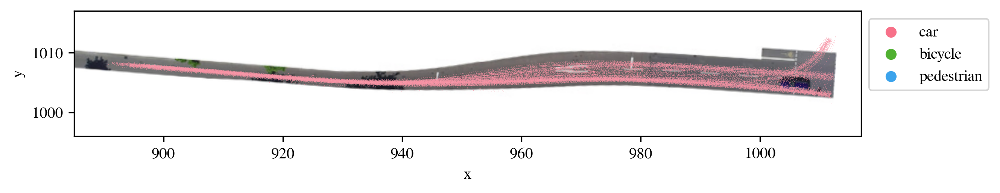

In [2]:
transform1 = mtransforms.Affine2D().scale(0.14).rotate_deg(-4).translate(878, 1003)
interaction.plot_map_and_trajectories(
    "DR_DEU_Merging_MT", data_path, img_path, transform1, trajectory_types, configs
)

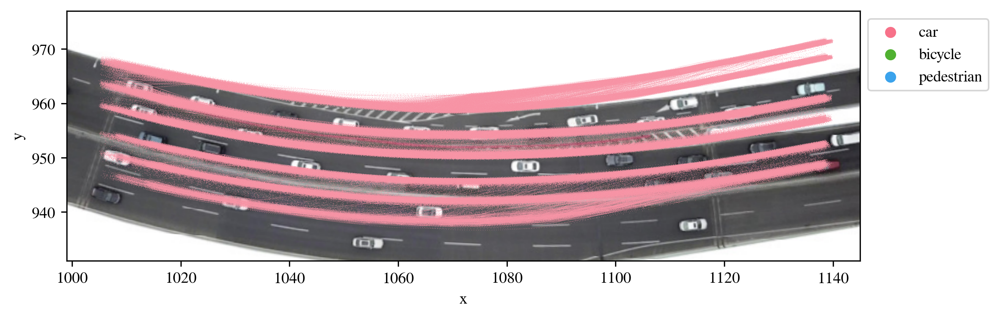

In [ ]:
transform2 = mtransforms.Affine2D().scale(0.165).rotate_deg(3).translate(988, 931)
interaction.plot_map_and_trajectories(
    "DR_CHN_Merging_ZS", data_path, img_path, transform2, trajectory_types, configs
)

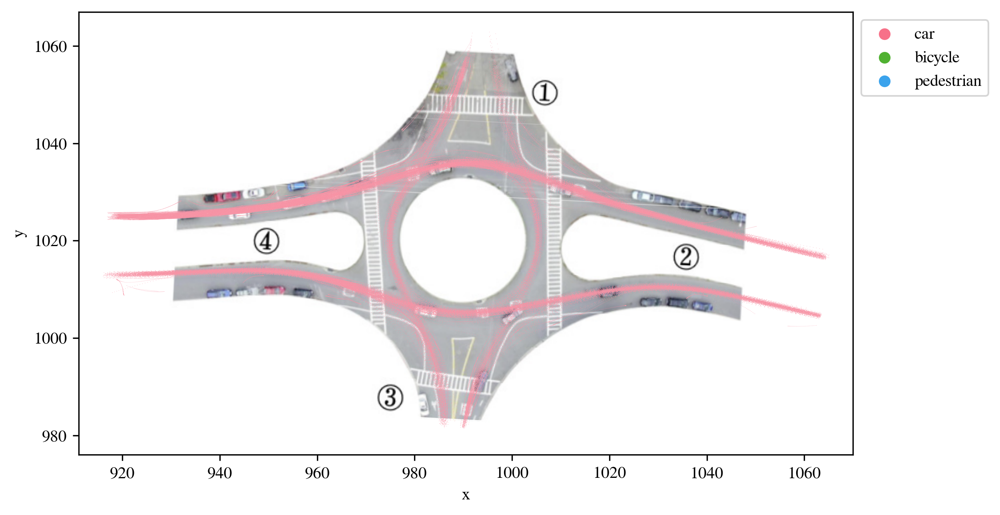

In [4]:
transform3 = mtransforms.Affine2D().scale(0.17).rotate_deg(-3).translate(926.5, 985)
interaction.plot_map_and_trajectories(
    "DR_USA_Roundabout_SR", data_path, img_path, transform3, trajectory_types, configs
)

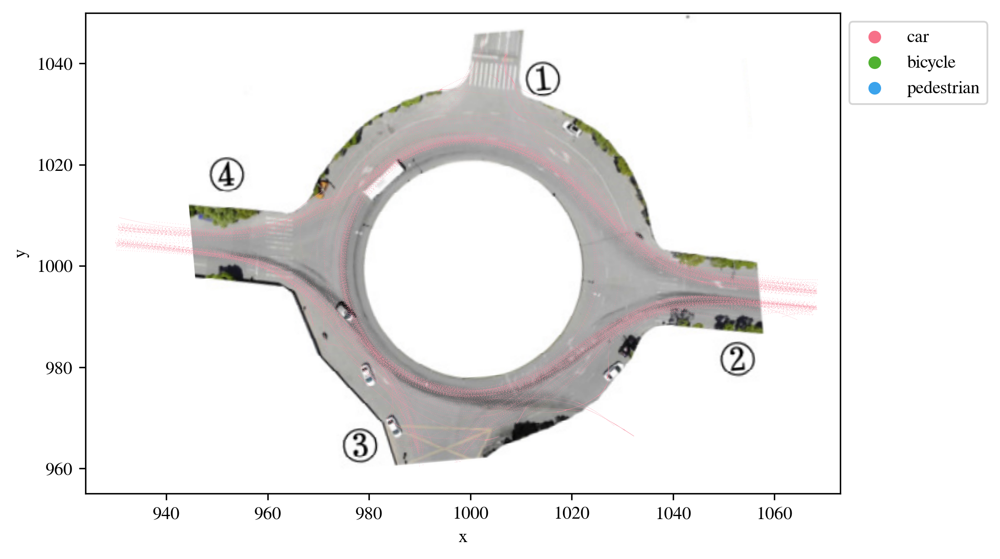

In [5]:
transform4 = mtransforms.Affine2D().scale(0.22).rotate_deg(5).translate(946, 955)
interaction.plot_map_and_trajectories(
    "DR_CHN_Roundabout_LN", data_path, img_path, transform4, trajectory_types, configs
)

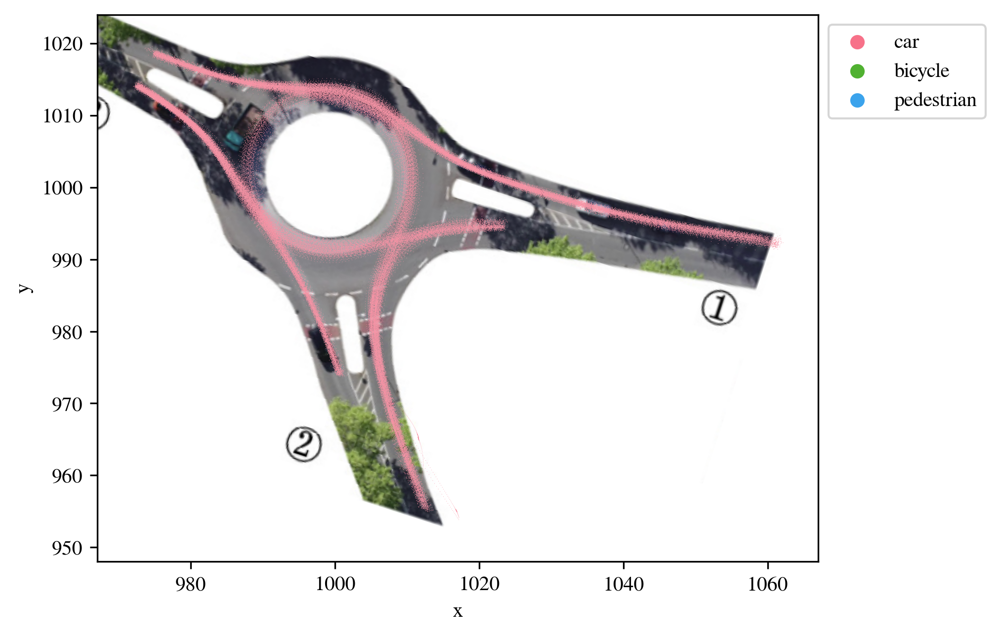

In [6]:
transform5 = mtransforms.Affine2D().scale(0.16).rotate_deg(-18).translate(949, 973)
interaction.plot_map_and_trajectories(
    "DR_DEU_Roundabout_OF", data_path, img_path, transform5, trajectory_types, configs
)

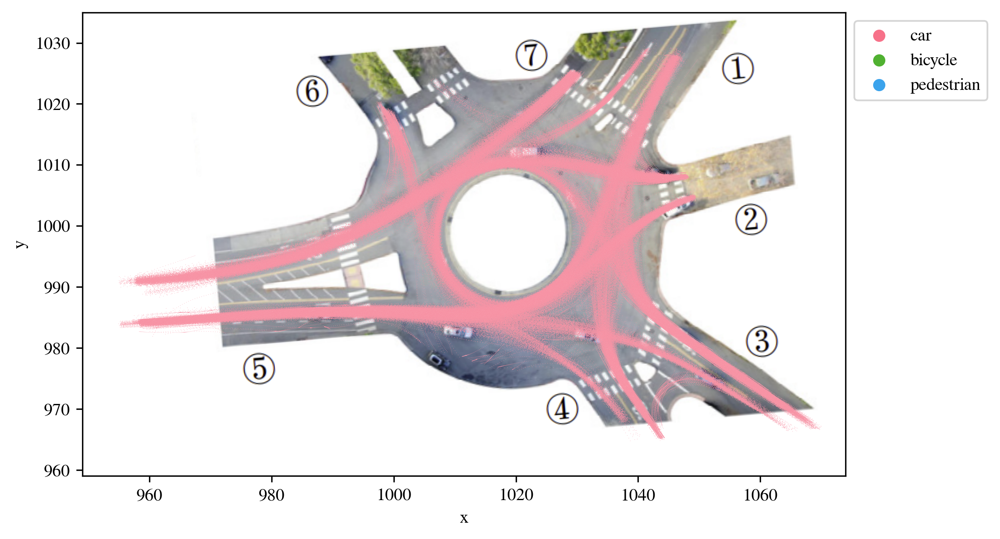

In [7]:
transform6 = mtransforms.Affine2D().scale(0.17).rotate_deg(5).translate(972, 960)
interaction.plot_map_and_trajectories(
    "DR_USA_Roundabout_FT", data_path, img_path, transform6, trajectory_types, configs
)

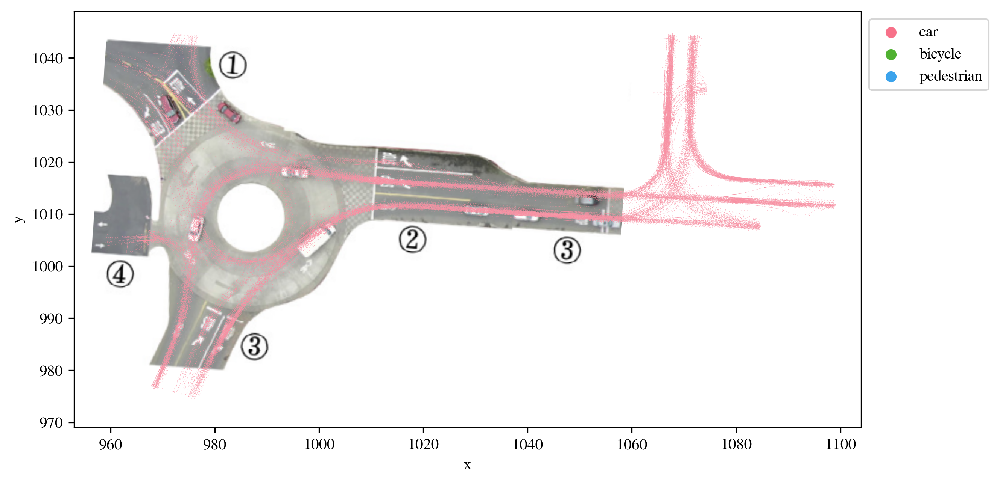

In [8]:
transform7 = mtransforms.Affine2D().scale(0.17).rotate_deg(-4).translate(952, 981)
interaction.plot_map_and_trajectories(
    "DR_USA_Roundabout_EP", data_path, img_path, transform7, trajectory_types, configs
)

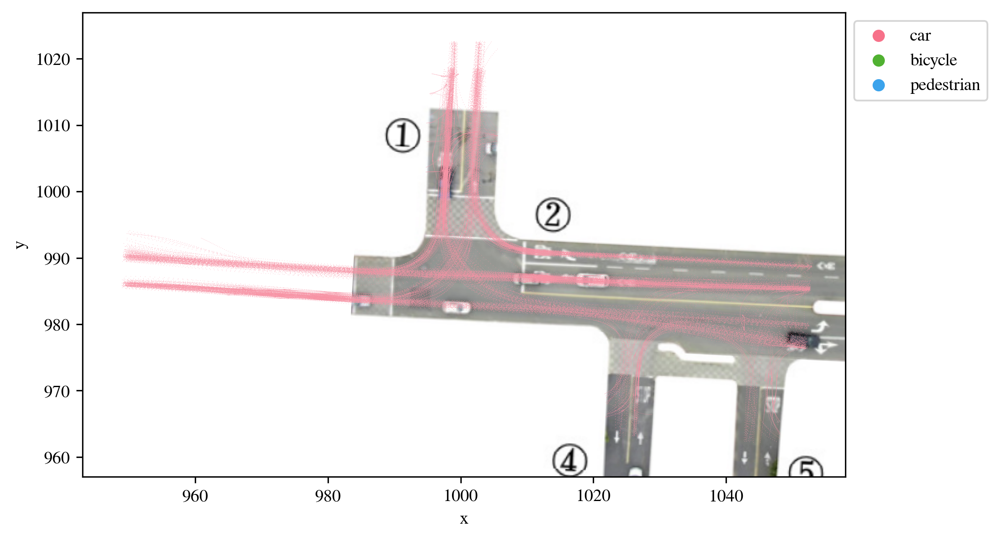

In [9]:
transform8 = mtransforms.Affine2D().scale(0.17).rotate_deg(-3).translate(982, 952)
interaction.plot_map_and_trajectories(
    "DR_USA_Intersection_EP0", data_path, img_path, transform8, trajectory_types, configs
)

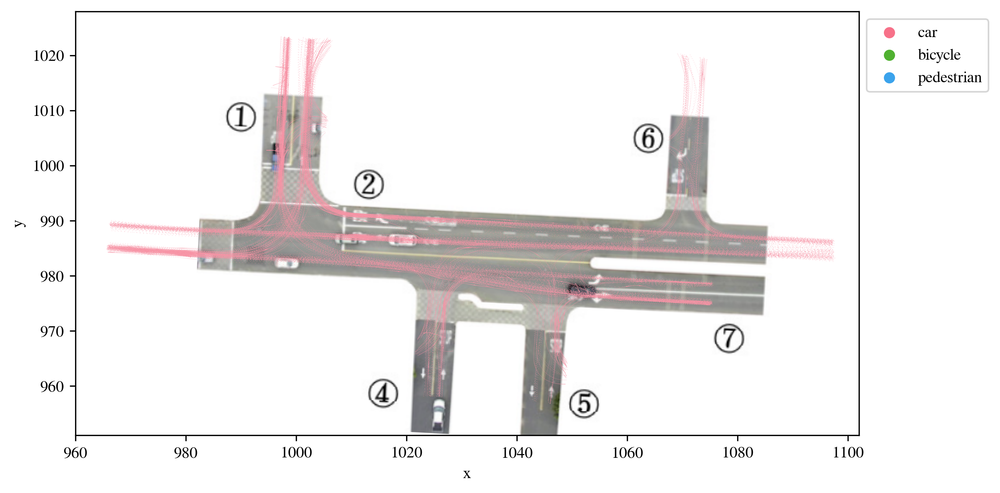

In [10]:
transform9 = mtransforms.Affine2D().scale(0.174).rotate_deg(-3).translate(980.5, 951)
interaction.plot_map_and_trajectories(
    "DR_USA_Intersection_EP1", data_path, img_path, transform9, trajectory_types, configs
)

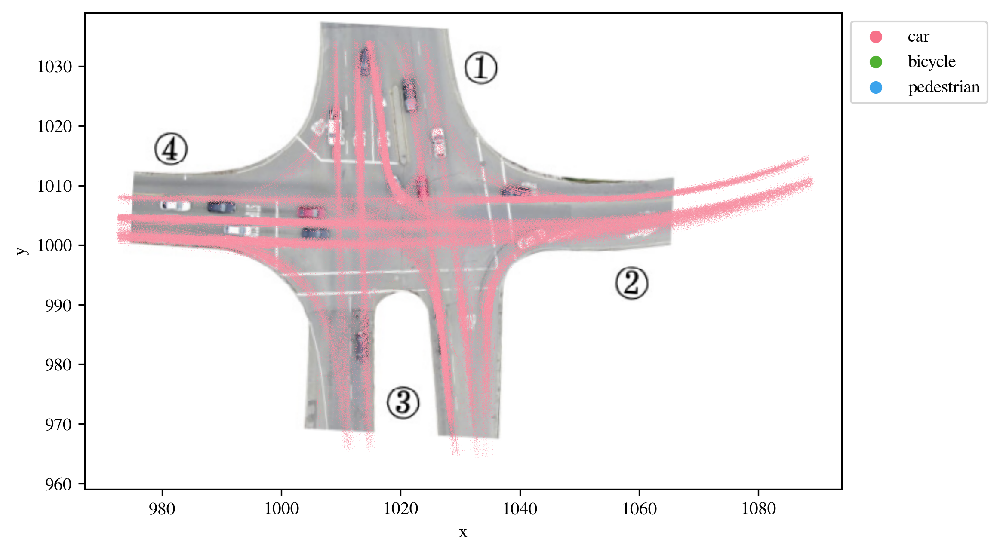

In [11]:
transform10 = mtransforms.Affine2D().scale(0.18).rotate_deg(-3).translate(972, 970)
interaction.plot_map_and_trajectories(
    "DR_USA_Intersection_MA", data_path, img_path, transform10, trajectory_types, configs
)

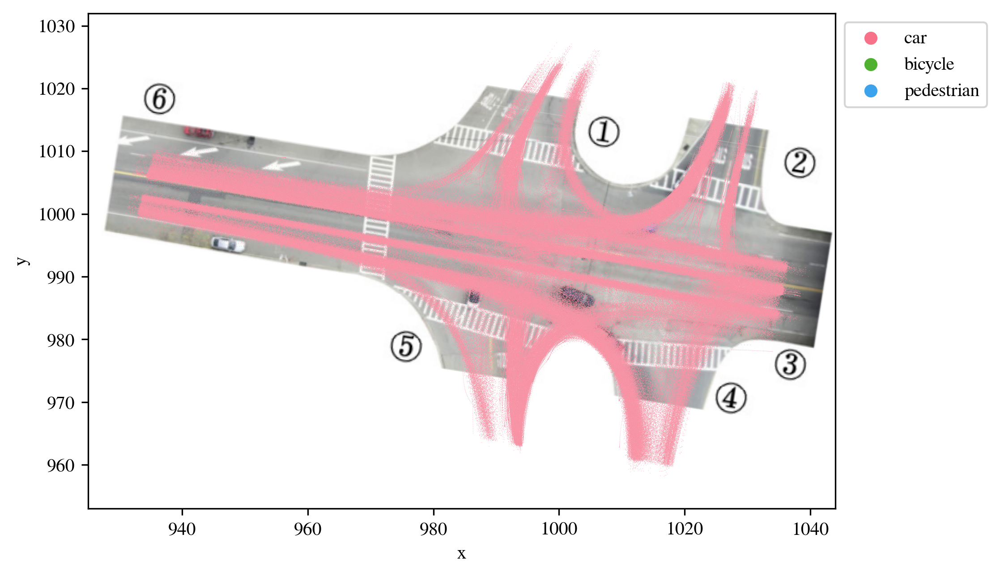

In [12]:
transform11 = mtransforms.Affine2D().scale(0.16).rotate_deg(-9).translate(924, 983)
interaction.plot_map_and_trajectories(
    "DR_USA_Intersection_GL", data_path, img_path, transform11, trajectory_types, configs
)

### Proportion of Trajectory Types

In [13]:
def type_vis(map_config):
    type_set = set()
    type_count_dict = dict()
    track_files = os.listdir("../data/tracks/%s/" % map_config["map_name"])
    for track_file in sorted(track_files):
        dir_file = "../data/tracks/%s/%s" % (map_config["map_name"], track_file)
        df = pd.read_csv(dir_file)
        type_count = defaultdict(int)
        veh_ids = df["id"].unique()
        for veh_id in veh_ids:
            line_id = df[df["id"] == veh_id].index[0]
            type_count[df["type"].loc[line_id]] += 1
        type_set = type_set | set(type_count.keys())
        type_count_dict[track_file[0:3]] = type_count
    df = pd.DataFrame(columns=sorted(type_set))
    i = 0
    for track_id, type_count in type_count_dict.items():
        df.at[i, "track_id"] = track_id
        total = 0
        for n in type_count.values():
            total += n
        print("There are in total %d agents in file %s" % (total, track_id))
        for type in type_set:
            df.at[i, type] = type_count[type] / total
        i += 1
    df.plot(
        x="track_id",
        kind="barh",
        stacked=True,
        title=map_config["map_name"],
        colormap="Set2",
        mark_right=True,
    )
    fig = plt.gcf()
    fig.set_size_inches((8, 0.5 * len(df)))
    plt.legend(loc="center left", bbox_to_anchor=(1, 0.5))

### Speed Distribution

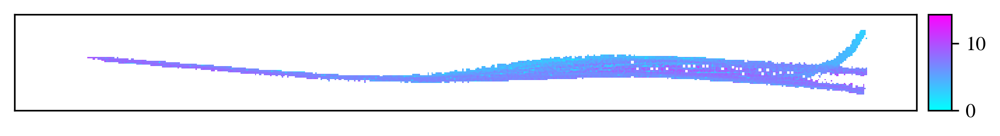

In [14]:
interaction.plot_speed_distribution("DR_DEU_Merging_MT", [880, 1020, 1000, 1015], data_path, configs)

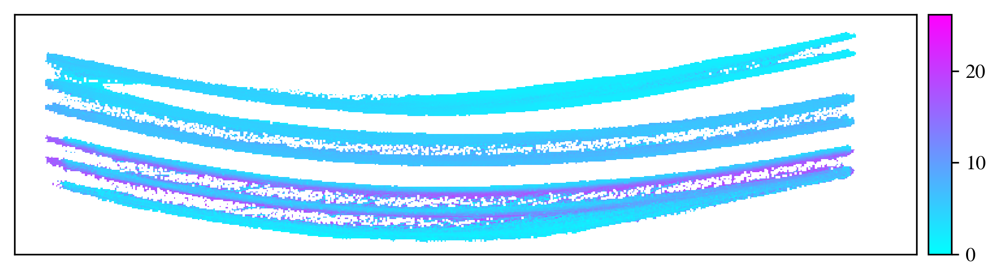

In [15]:
interaction.plot_speed_distribution("DR_CHN_Merging_ZS", [1000, 1150, 935, 975], data_path, configs)

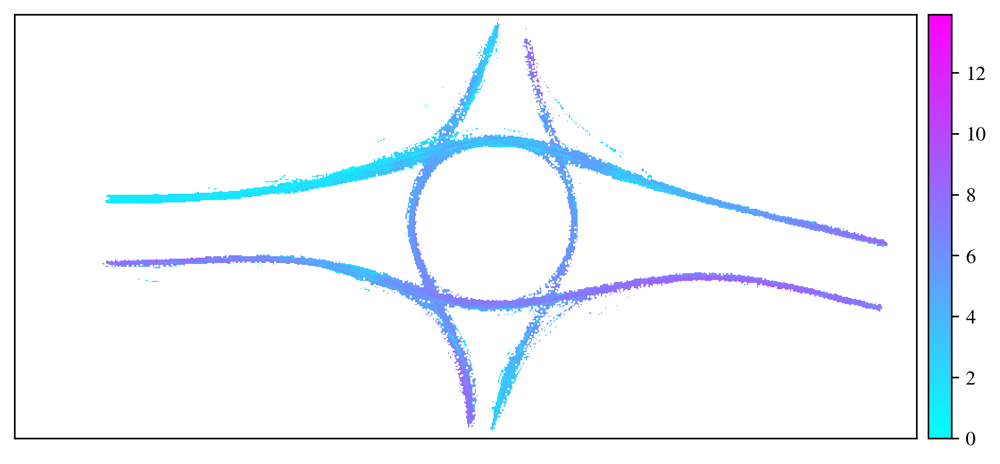

In [16]:
interaction.plot_speed_distribution("DR_USA_Roundabout_SR", [900, 1070, 980, 1060], data_path, configs)

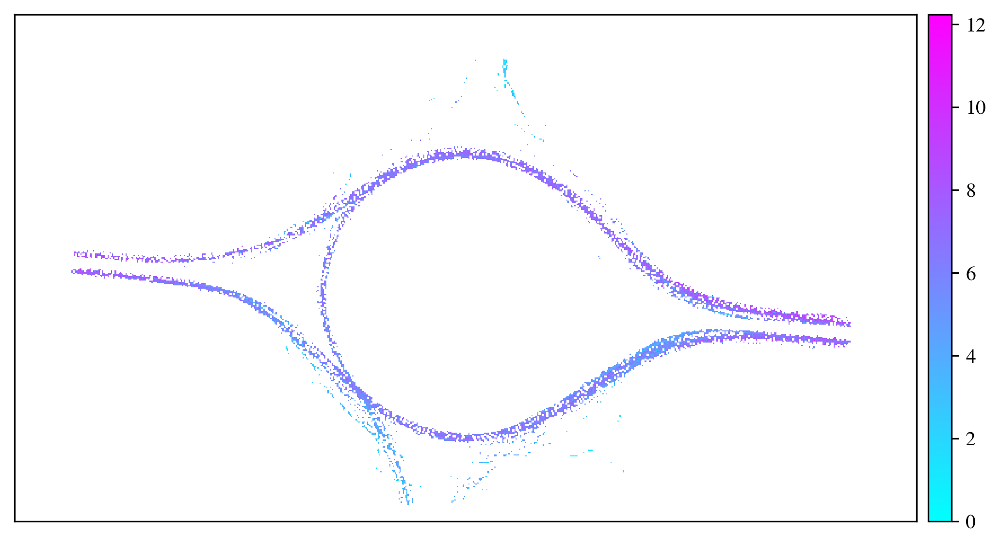

In [17]:
interaction.plot_speed_distribution("DR_CHN_Roundabout_LN", [920, 1080, 960, 1050], data_path, configs)

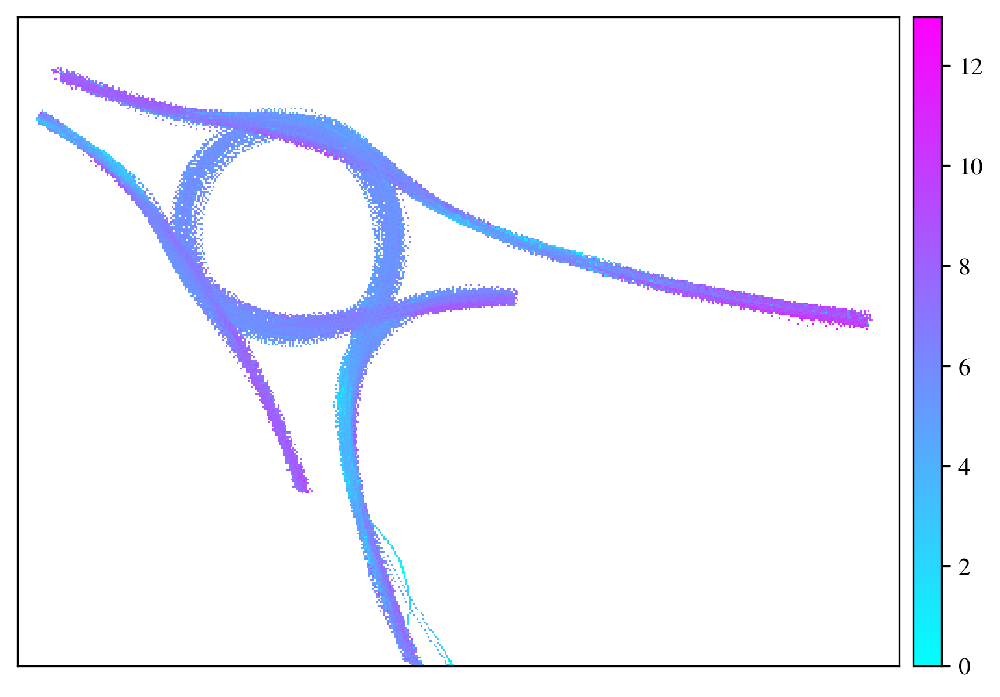

In [18]:
interaction.plot_speed_distribution("DR_DEU_Roundabout_OF", [970, 1065, 955, 1025], data_path, configs)

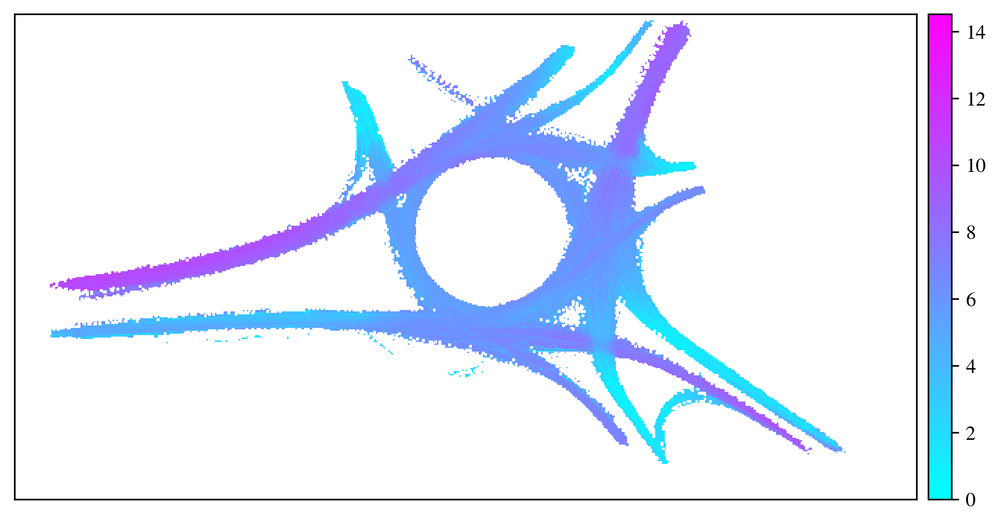

In [19]:
interaction.plot_speed_distribution("DR_USA_Roundabout_FT", [950, 1080, 960, 1030], data_path, configs)

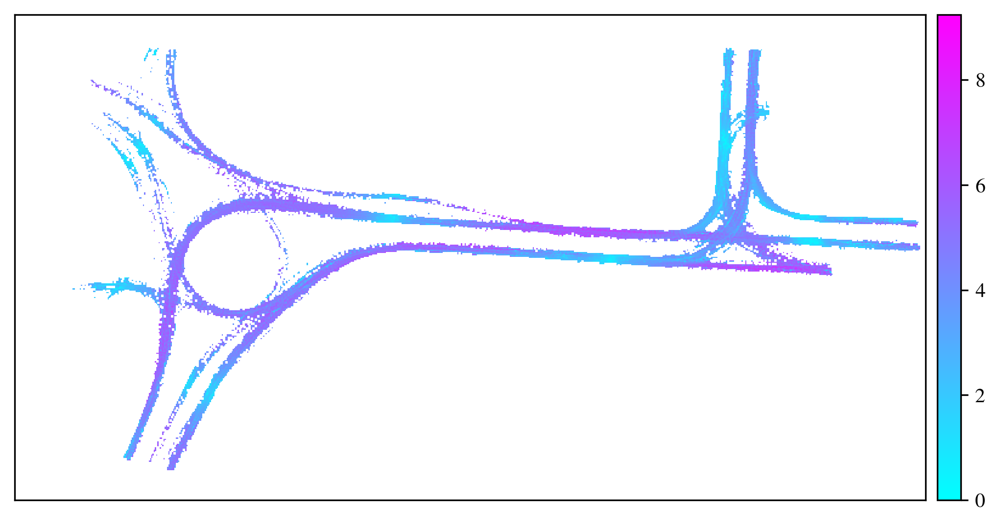

In [20]:
interaction.plot_speed_distribution("DR_USA_Roundabout_EP", [950, 1100, 970, 1050], data_path, configs)

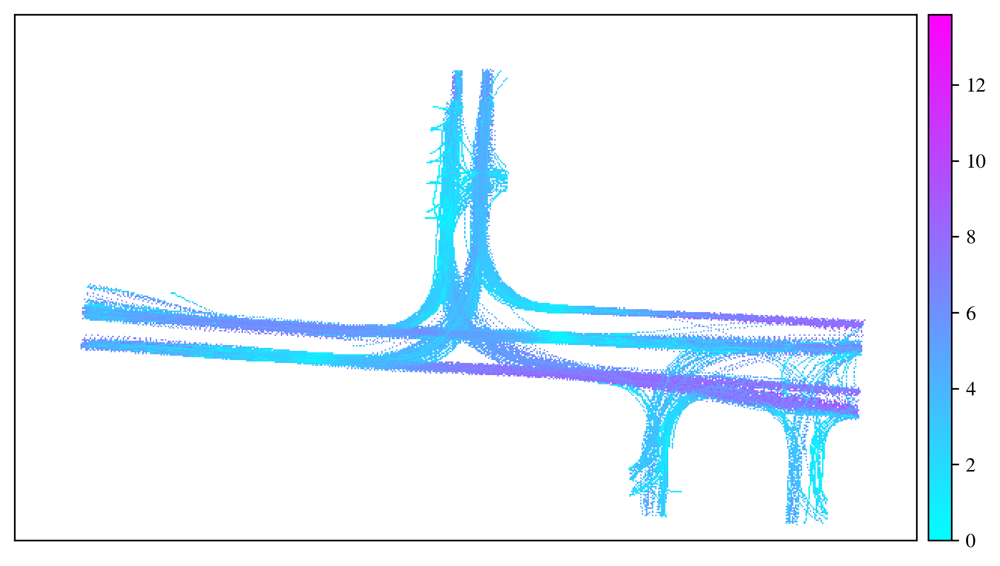

In [21]:
interaction.plot_speed_distribution("DR_USA_Intersection_EP0", [940, 1060, 960, 1030], data_path, configs)

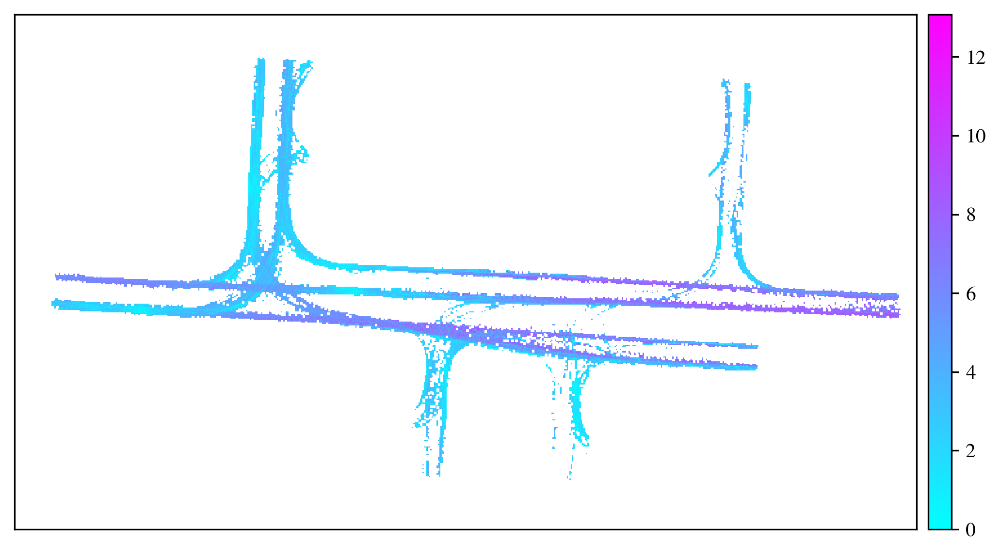

In [22]:
interaction.plot_speed_distribution("DR_USA_Intersection_EP1", [960, 1100, 950, 1030], data_path, configs)

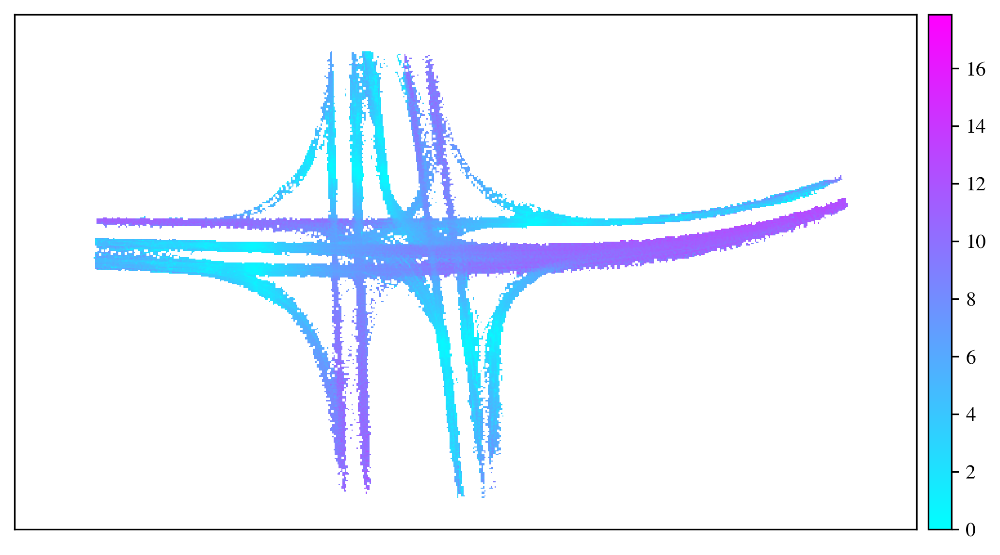

In [23]:
interaction.plot_speed_distribution("DR_USA_Intersection_MA", [960, 1100, 960, 1040], data_path, configs)

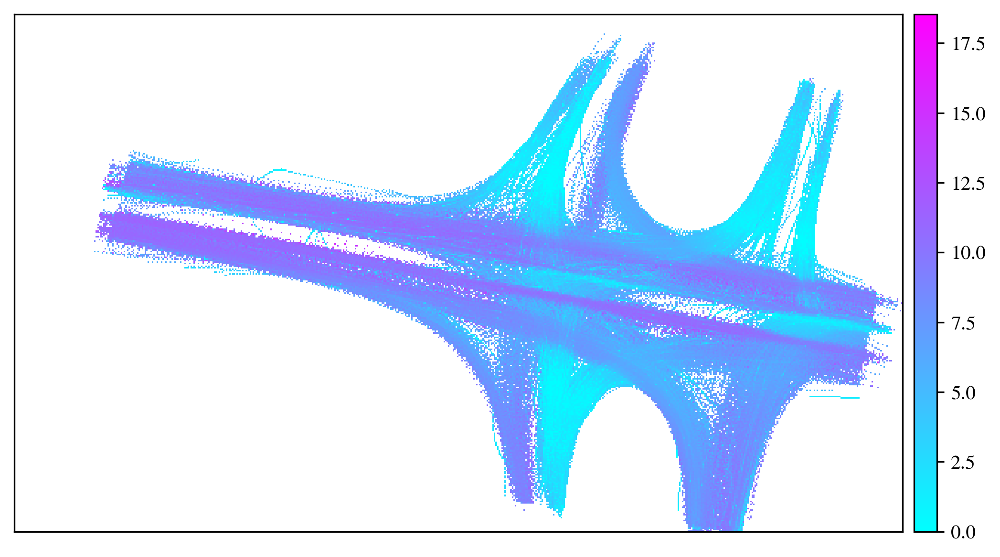

In [24]:
interaction.plot_speed_distribution("DR_USA_Intersection_GL", [920, 1040, 960, 1030], data_path, configs)

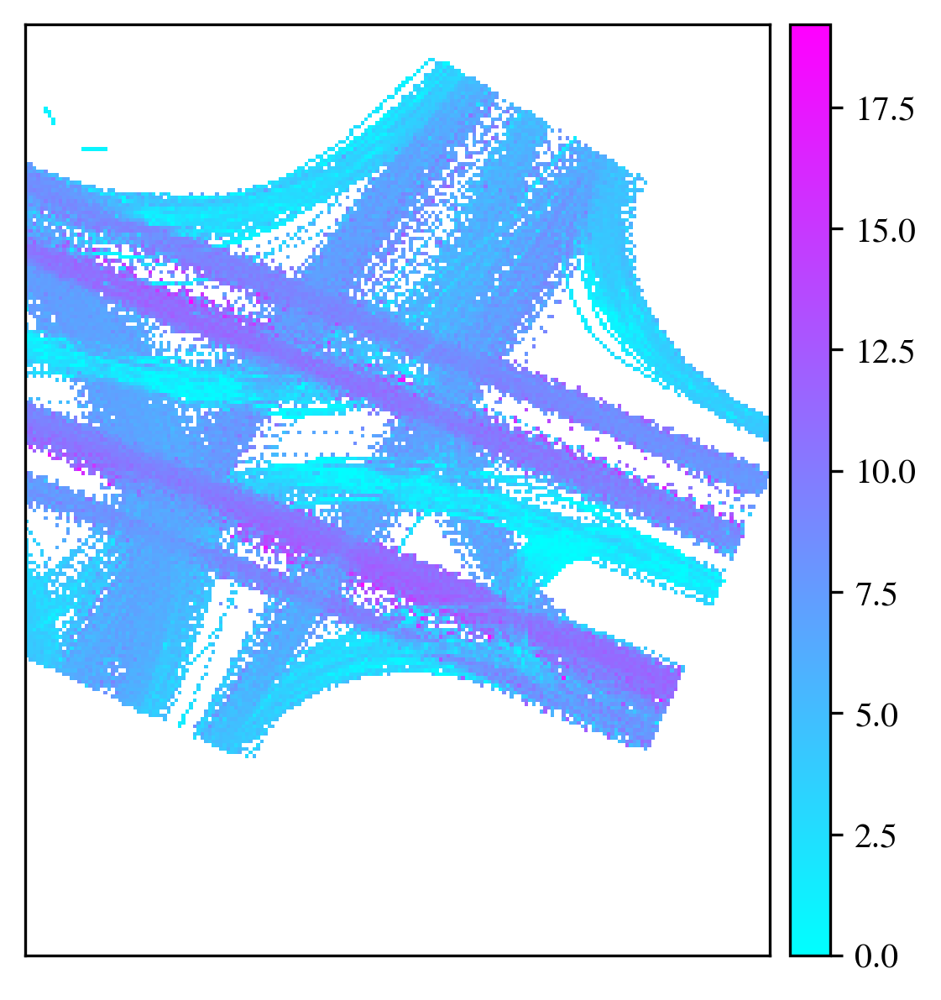

In [25]:
interaction.plot_speed_distribution("TC_BGR_Intersection_VA", [980, 1020, 970, 1020], data_path, configs)

In [26]:
def speed_dist_vis(map_config, types):
    track_files = os.listdir("../data/tracks/%s/" % map_config["map_name"])
    for type in types:
        for file in sorted(track_files):
            df = pd.read_csv("../data/tracks/%s/%s" % (map_config["map_name"], file))
            sns.distplot(df[df["type"] == type]["v"], label=file, hist=False)
            fig = plt.gcf()
            fig.set_size_inches((8, 6))
            ax = plt.gca()
            ax.set_title(type)
        plt.set_cmap("Set2")
        plt.legend(loc="center left", bbox_to_anchor=(1, 0.5))
        plt.show()

In [27]:
speed_dist_vis(configs[intersected_map_list[0]], ["bicycle", "car", "pedestrian"])

NameError: name 'intersected_map_list' is not defined

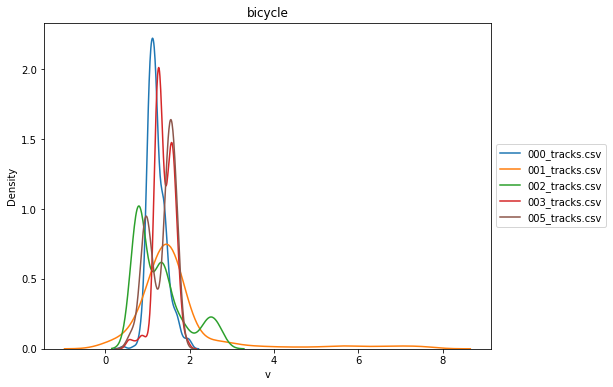

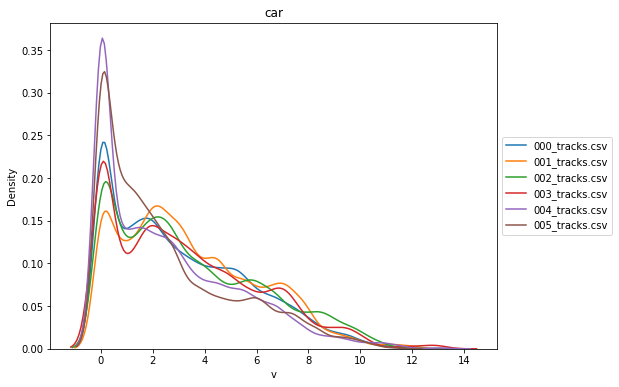

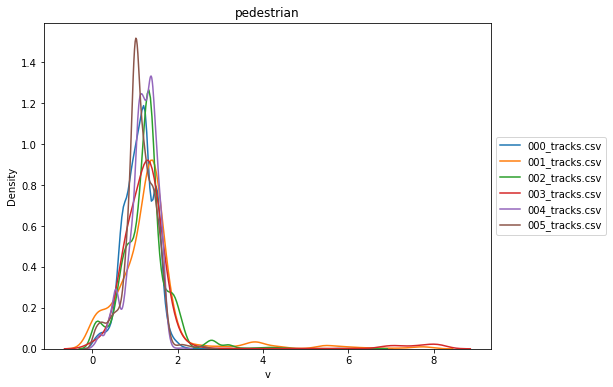

In [ ]:
speed_dist_vis(configs[intersected_map_list[1]], ["bicycle", "car", "pedestrian"])

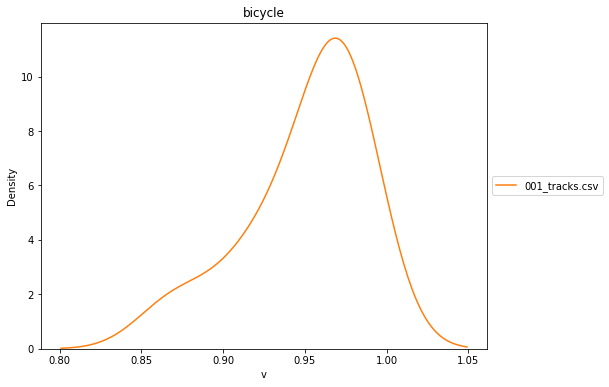

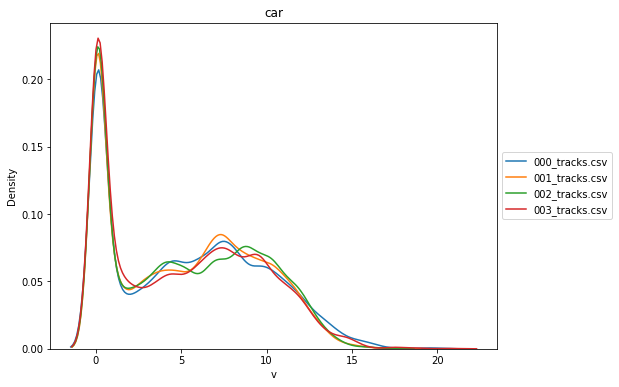

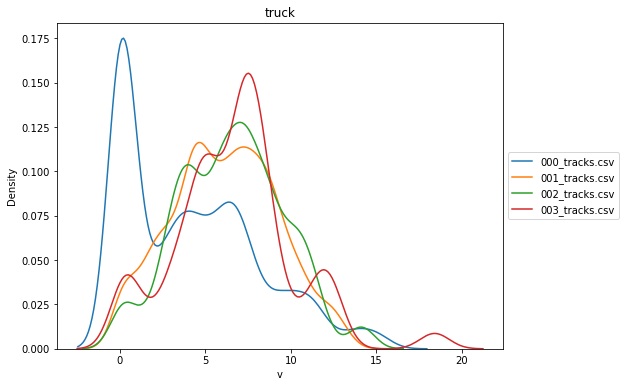

In [ ]:
speed_dist_vis(configs[signed_intersected_map_list[0]], ["bicycle", "car", "truck"])

### Angle Distribution

In [ ]:
def angle_dist_vis(map_config, type, all_files=False):
    track_files = os.listdir("../data/tracks/%s/" % map_config["map_name"])
    file_list = track_files if all_files else [track_files[0]]
    for file in file_list:
        df = pd.read_csv("../data/tracks/%s/%s" % (map_config["map_name"], file))
        bin_num = 72
        theta = np.linspace(0.0, 2 * np.pi, bin_num, endpoint=False)
        angle = df[df["type"] == type]["angle"]
        for i, a in enumerate(angle):
            if a < 0:
                angle[i] = angle[i] + 2 * np.pi
        radii = np.zeros(bin_num)
        for a in angle:
            radii[int(a / (2 * np.pi / bin_num))] += 1
        ax = plt.subplot(111, polar=True)
        bars = ax.bar(theta, np.log10(radii), width=(2 * np.pi) / bin_num, bottom=4)
        for r, bar in zip(radii, bars):
            bar.set_facecolor("turquoise")
            bar.set_alpha(0.5 + 0.5 * r / sum(radii))
        fig = plt.gcf()
        fig.set_size_inches((6, 6))
        ax = plt.gca()
        ax.set_title(file)
        plt.show()

The distribution of angle in all track files of map I_INTERACTION_0_USA are similar, so we only plot the first file.

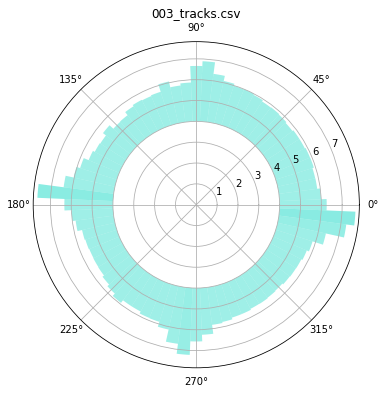

In [ ]:
angle_dist_vis(configs[intersected_map_list[0]], "car")

The distribution of angle in all track files of map I_INTERACTION_1_USA are similar, so we only plot the first file.

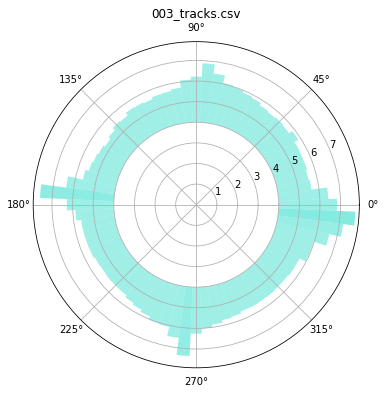

In [ ]:
angle_dist_vis(configs[intersected_map_list[1]], "car")

The distribution of angle in all track files of map I_INTERACTION_2_USA are similar, so we only plot the first file.

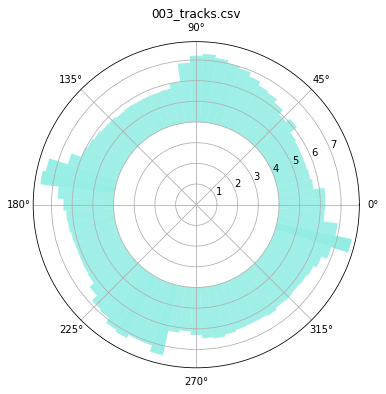

In [ ]:
angle_dist_vis(configs[intersected_map_list[2]], "car")

The distribution of angle in all track files of map I_INTERACTION_3_USA are similar, so we only plot the first file.

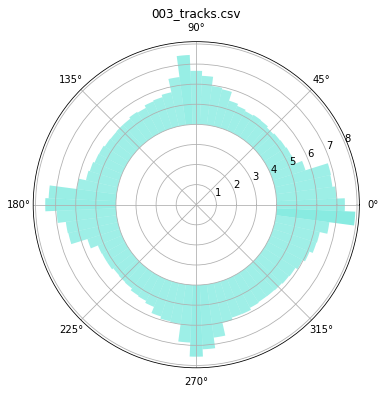

In [ ]:
angle_dist_vis(configs[intersected_map_list[3]], "car")

### Traffic Density

In [ ]:
def traffic_density_vis(map_config, x_lim, y_lim, all_files=True):
    track_files = sorted(os.listdir("../data/tracks/%s/" % map_config["map_name"]))
    file_list = track_files if all_files else [track_files[0]]
    for file in file_list:
        df = pd.read_csv("../data/tracks/%s/%s" % (map_config["map_name"], file))
        count = df.groupby(["frame", "type"]).size().unstack(level=1)
        count.plot(kind="line")
        ax = plt.gca()
        ax.set_xlim(x_lim)
        ax.set_ylim(y_lim)
        ax.set_title(file)
        fig = plt.gcf()
        fig.set_size_inches((8, 6))
        plt.set_cmap("Set2")
        plt.legend(loc="center left", bbox_to_anchor=(1, 0.5))
        plt.show()

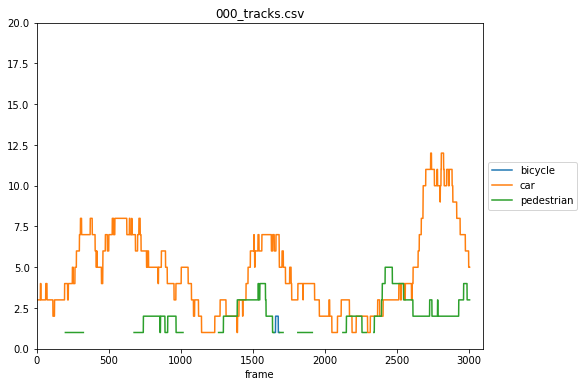

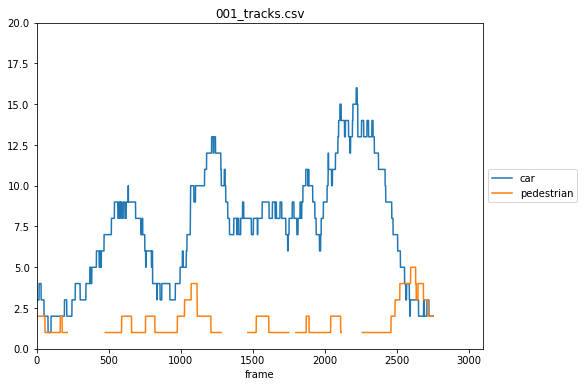

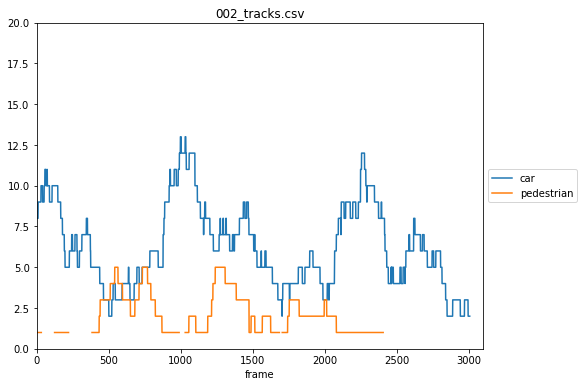

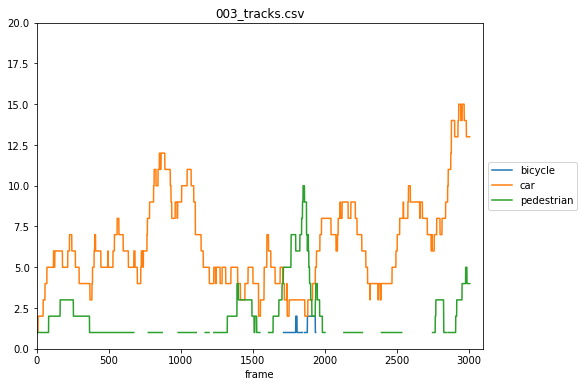

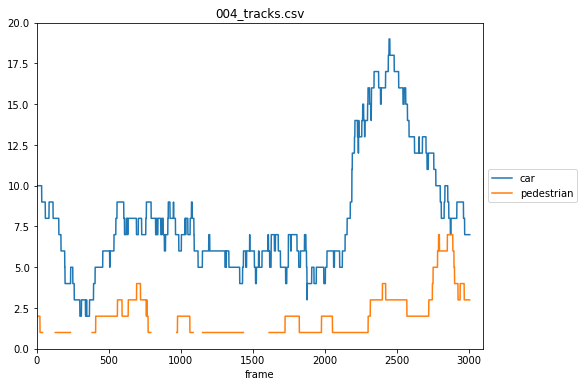

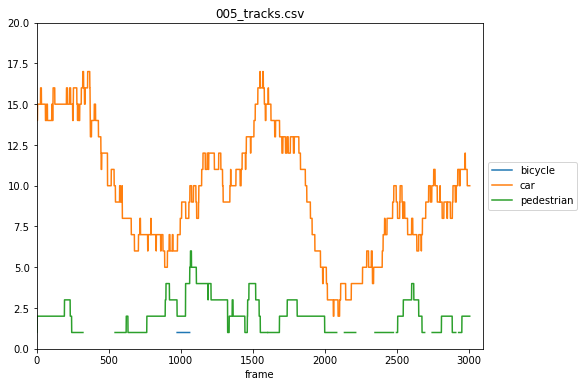

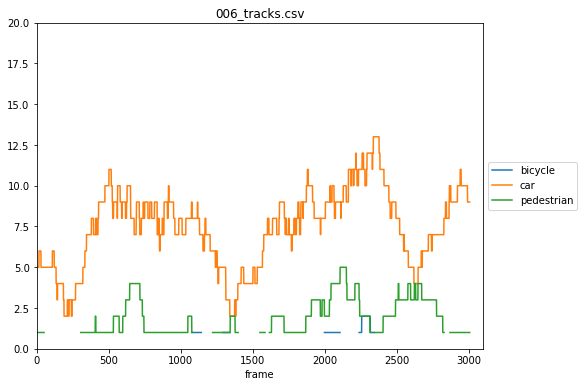

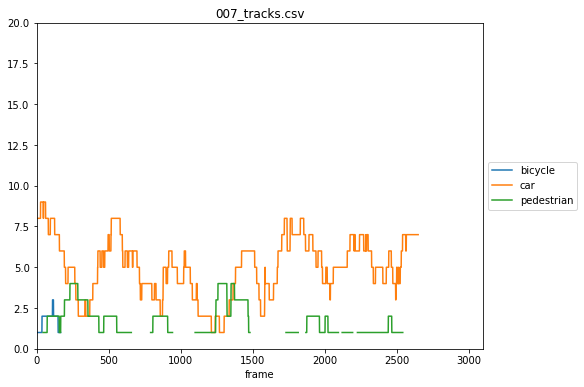

In [ ]:
traffic_density_vis(configs[intersected_map_list[0]], x_lim=[0, 3100], y_lim=[0, 20])

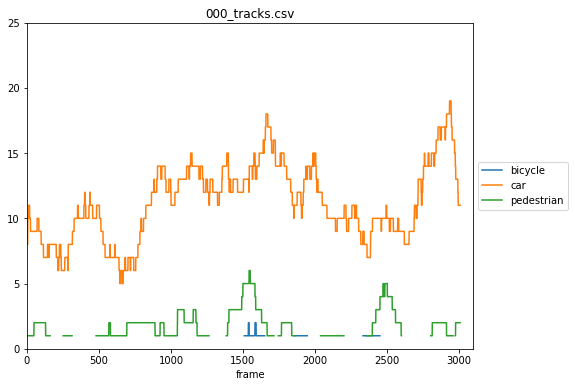

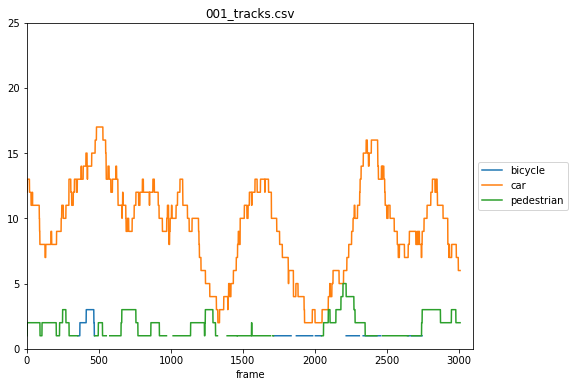

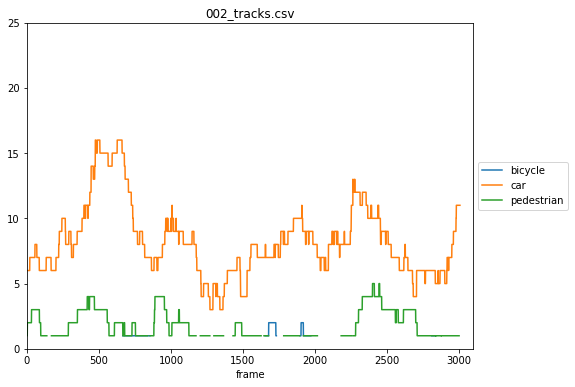

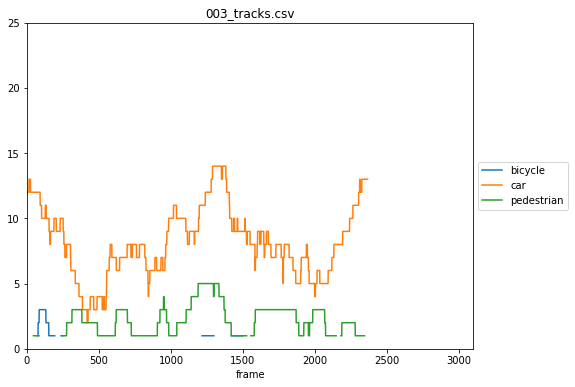

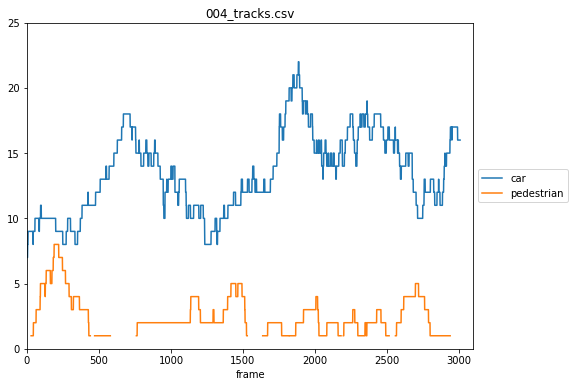

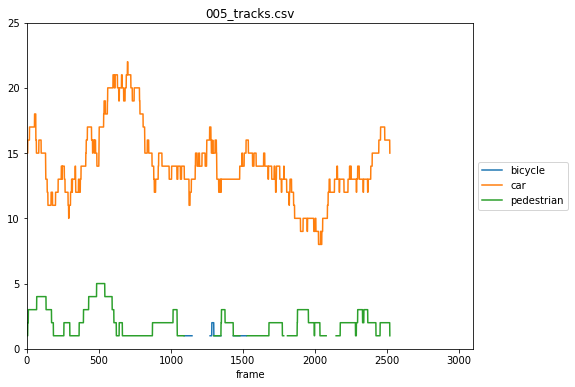

In [ ]:
traffic_density_vis(configs[intersected_map_list[1]], x_lim=[0, 3100], y_lim=[0, 25])

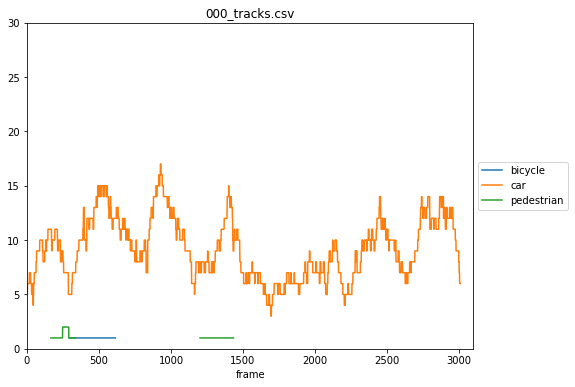

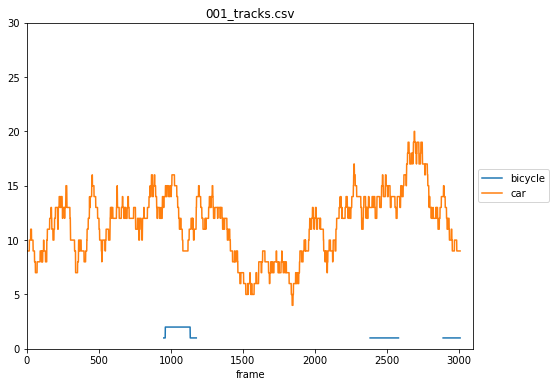

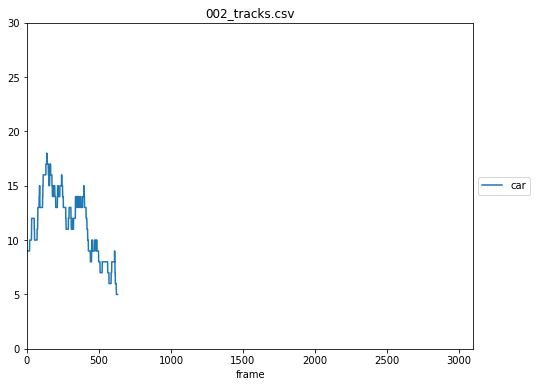

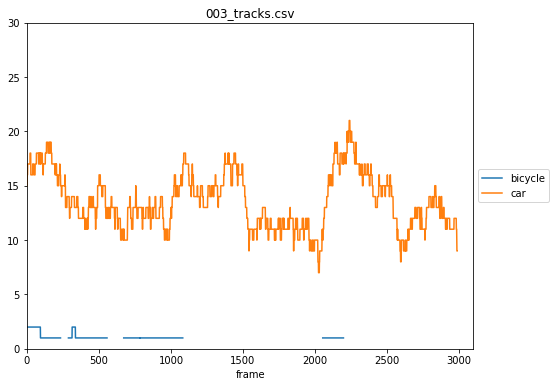

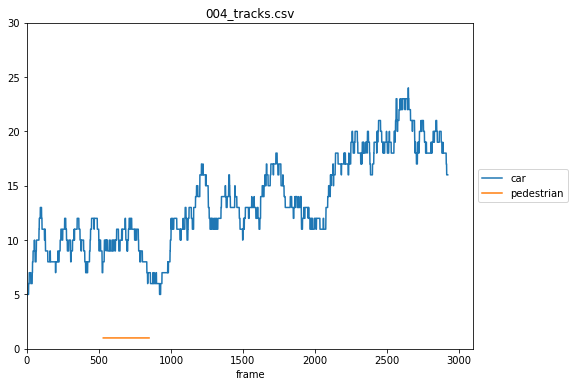

...

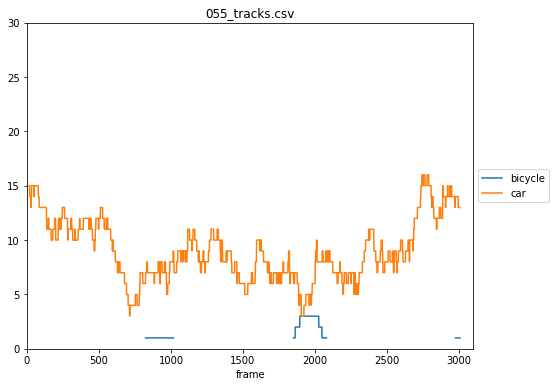

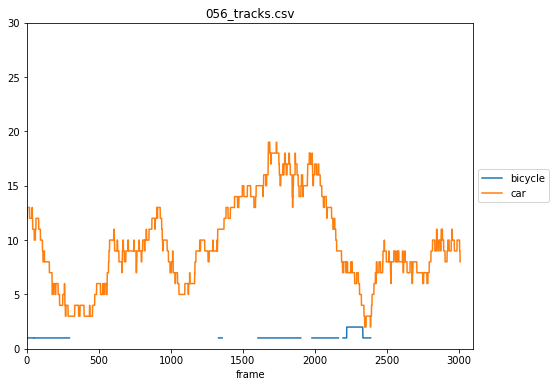

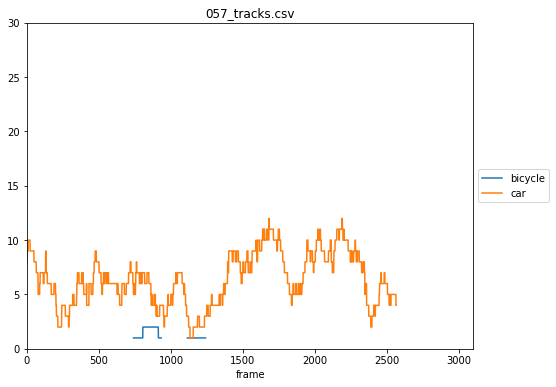

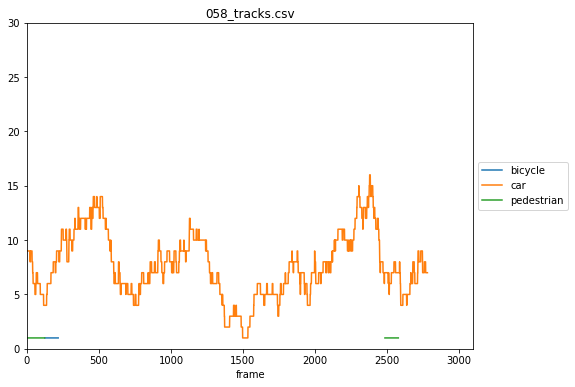

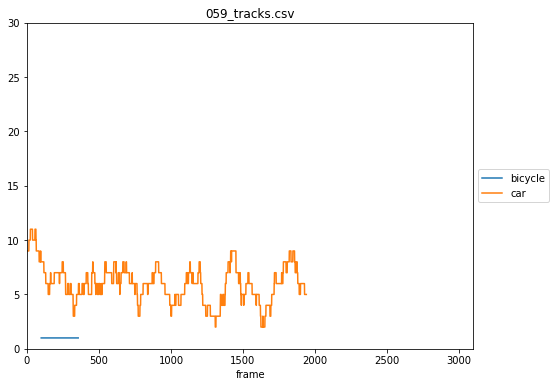

In [ ]:
traffic_density_vis(configs[intersected_map_list[2]], x_lim=[0, 3100], y_lim=[0, 30])

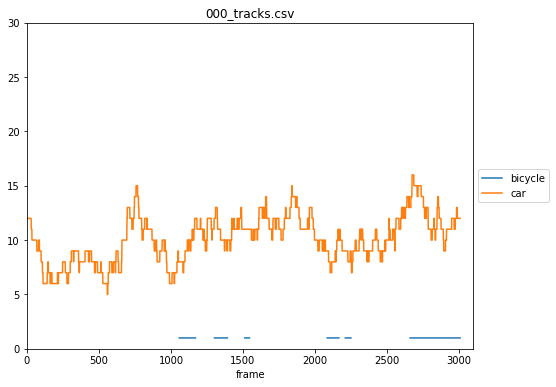

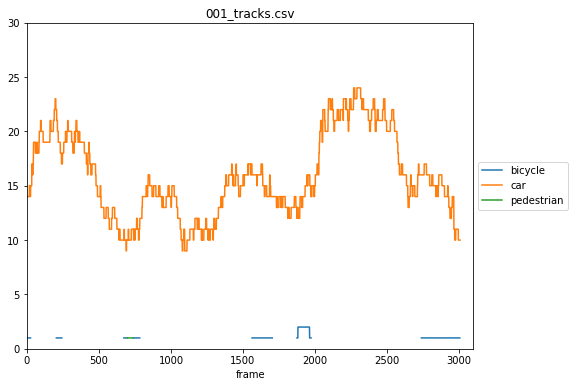

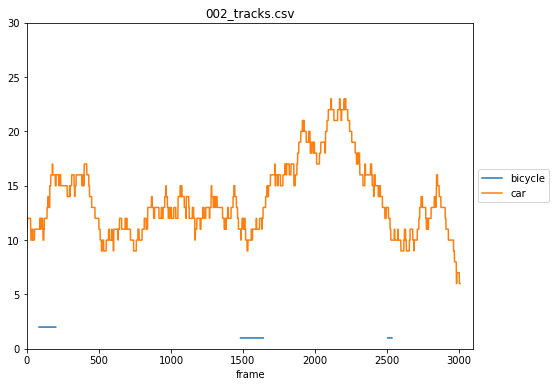

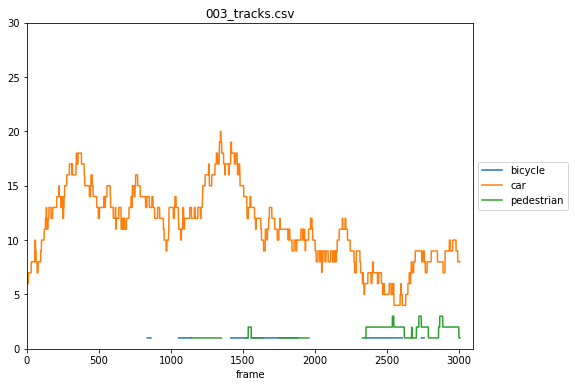

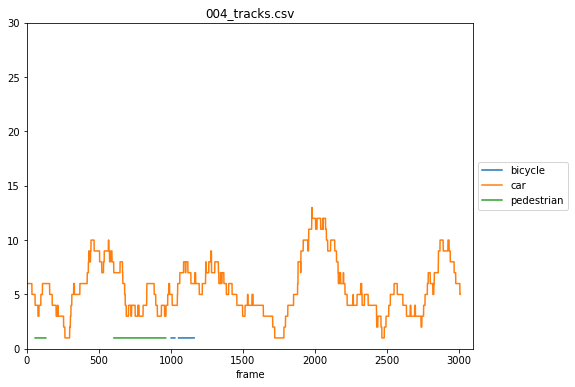

...

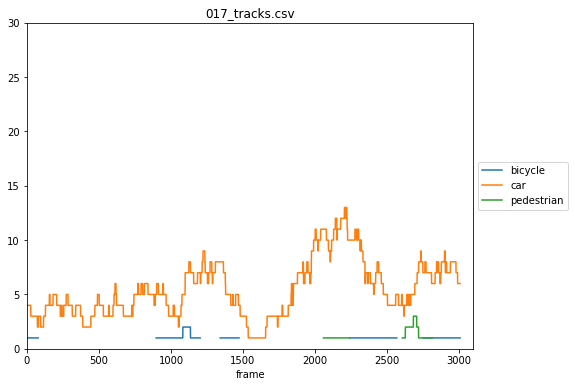

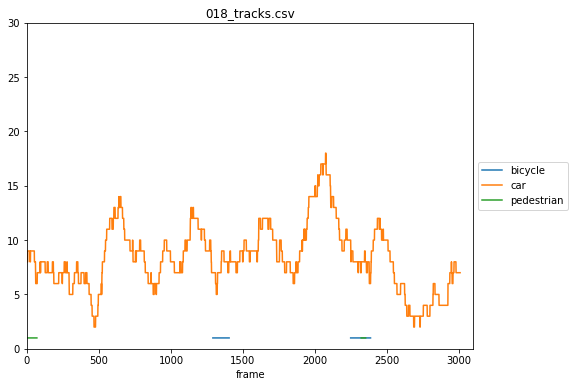

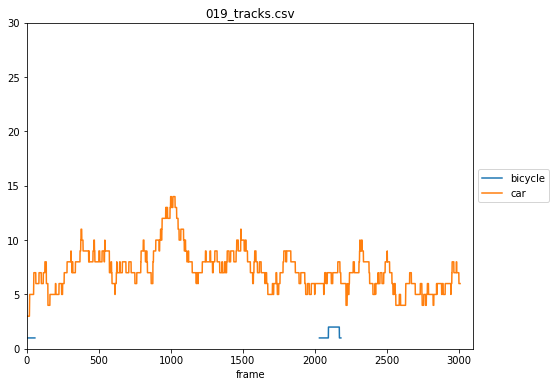

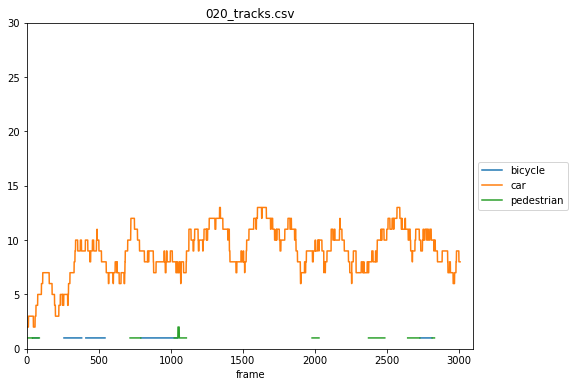

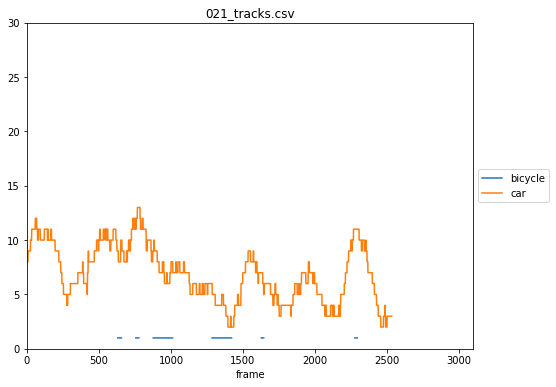

In [ ]:
traffic_density_vis(configs[intersected_map_list[3]], x_lim=[0, 3100], y_lim=[0, 30])

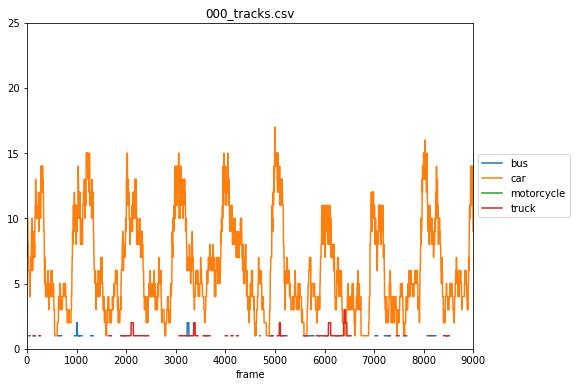

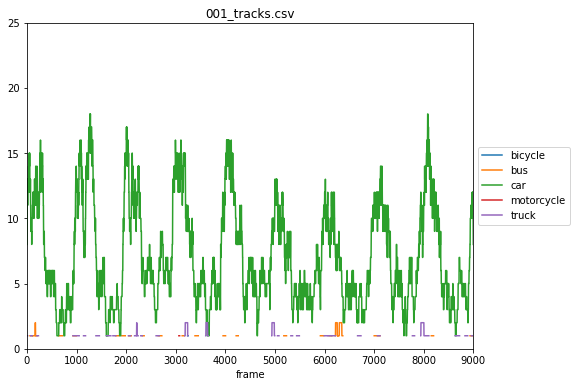

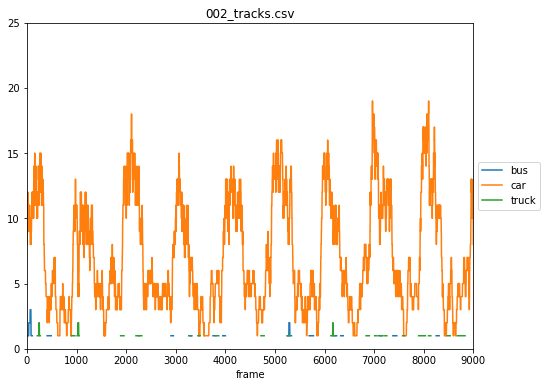

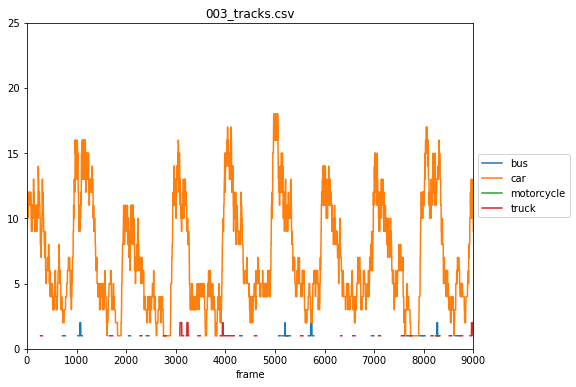

In [ ]:
traffic_density_vis(configs[signed_intersected_map_list[0]], x_lim=[0, 9000], y_lim=[0, 25])

## The Merging Scenarios

In [ ]:
merging_map_list = [m for m in map_list if m[0] == "M"]

In [ ]:
duration(configs[merging_map_list[0]])

Map: M_INTERACTION_0_DEU
Track file                Duration  
000_tracks.csv       915       
001_tracks.csv       559       
002_tracks.csv       974       
003_tracks.csv       644       
004_tracks.csv       838       
005_tracks.csv       702       
006_tracks.csv       795       
007_tracks.csv       924       
008_tracks.csv       481       
009_tracks.csv       1150      
010_tracks.csv       2807      
011_tracks.csv       3238      
012_tracks.csv       3271      
013_tracks.csv       3272      
014_tracks.csv       1745      


In [ ]:
duration(configs[merging_map_list[1]])

Map: M_INTERACTION_0_CHN
Track file                Duration  
000_tracks.csv       3511      
001_tracks.csv       5453      
002_tracks.csv       5452      
003_tracks.csv       5452      
004_tracks.csv       5449      
005_tracks.csv       5442      
006_tracks.csv       5452      
007_tracks.csv       5453      
008_tracks.csv       5452      
009_tracks.csv       5452      
010_tracks.csv       4095      


### Proportion of different agent type

There are in total 36 agents in file 000
There are in total 19 agents in file 001
There are in total 31 agents in file 002
There are in total 20 agents in file 003
There are in total 25 agents in file 004
There are in total 16 agents in file 005
There are in total 24 agents in file 006
There are in total 26 agents in file 007
There are in total 19 agents in file 008
There are in total 30 agents in file 009
There are in total 60 agents in file 010
There are in total 65 agents in file 011
There are in total 70 agents in file 012
There are in total 85 agents in file 013
There are in total 48 agents in file 014


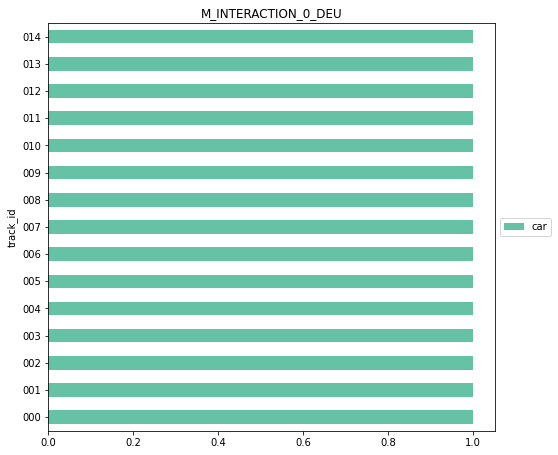

In [ ]:
type_vis(configs[merging_map_list[0]])

There are in total 684 agents in file 000
There are in total 1087 agents in file 001
There are in total 1039 agents in file 002
There are in total 1048 agents in file 003
There are in total 1074 agents in file 004
There are in total 992 agents in file 005
There are in total 983 agents in file 006
There are in total 1032 agents in file 007
There are in total 904 agents in file 008
There are in total 863 agents in file 009
There are in total 651 agents in file 010


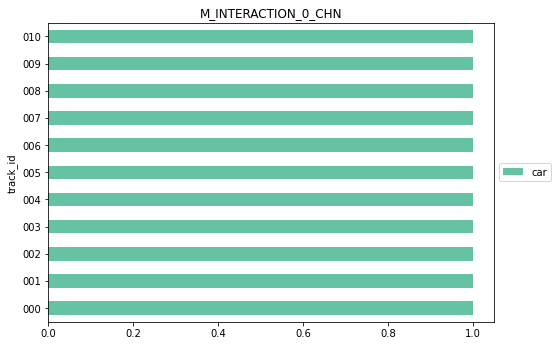

In [ ]:
type_vis(configs[merging_map_list[1]])

### Speed Distribution

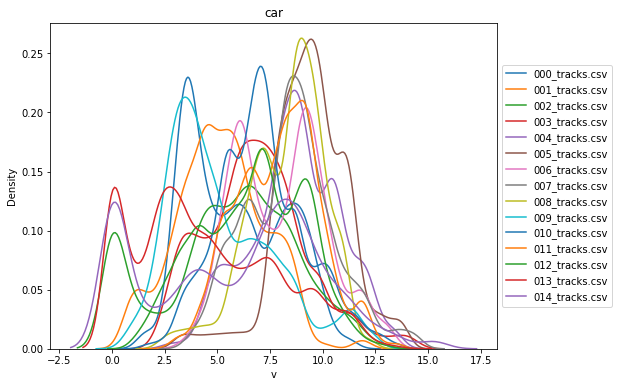

In [ ]:
speed_dist_vis(configs[merging_map_list[0]], ["car"])

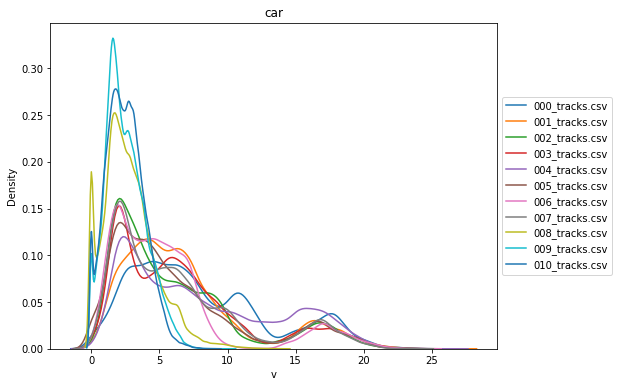

In [ ]:
speed_dist_vis(configs[merging_map_list[1]], ["car"])

### Traffic Density

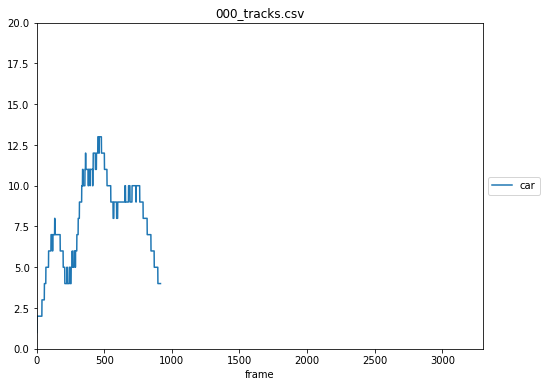

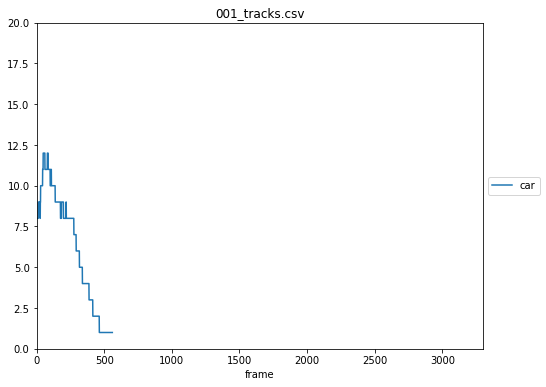

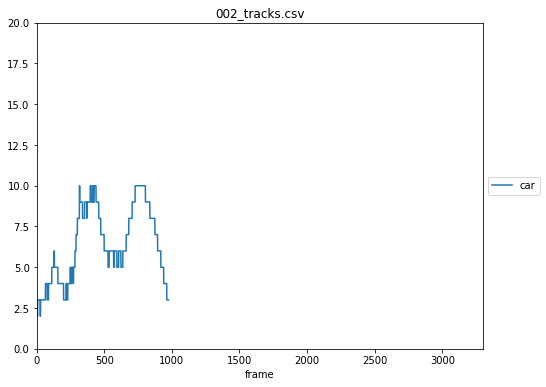

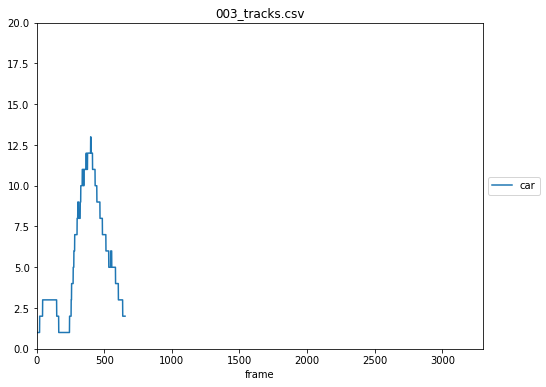

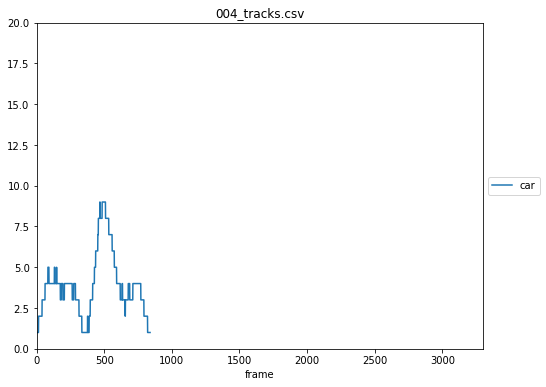

...

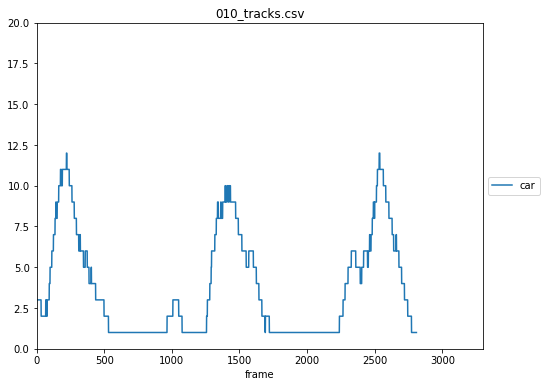

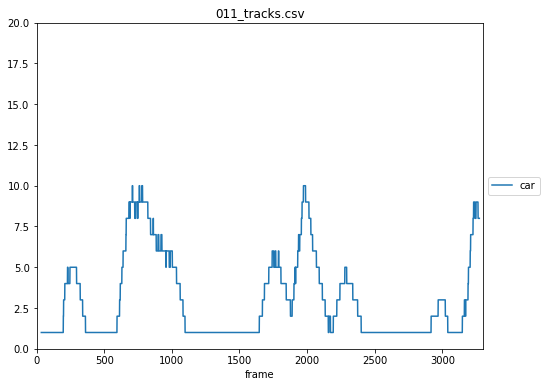

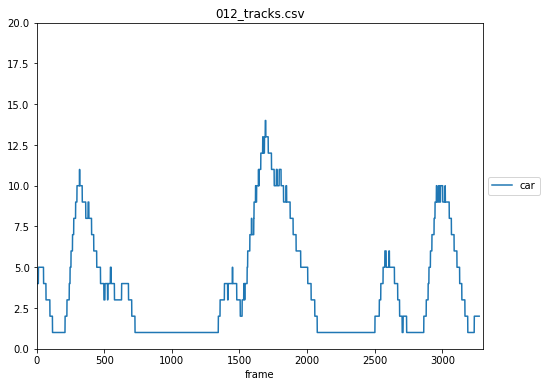

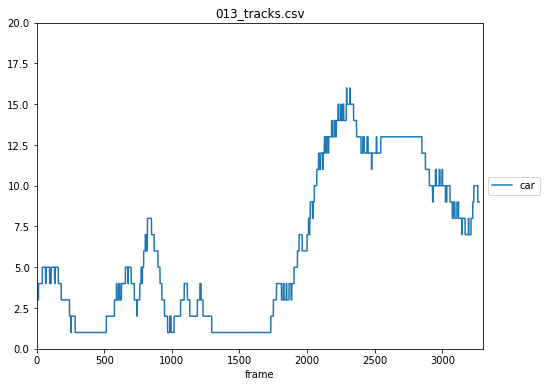

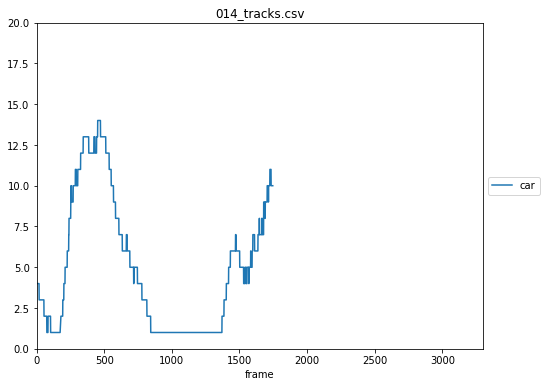

In [ ]:
traffic_density_vis(configs[merging_map_list[0]], x_lim=[0, 3300], y_lim=[0, 20])

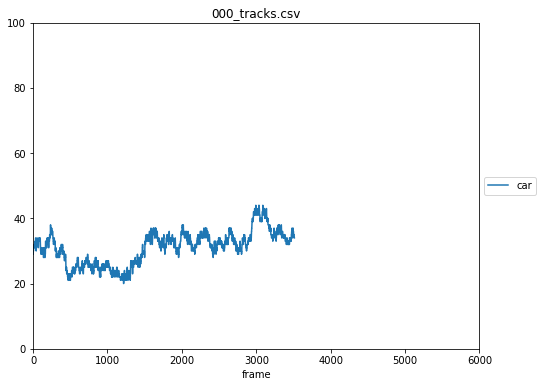

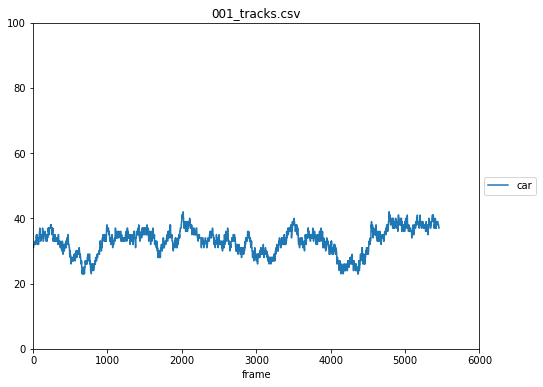

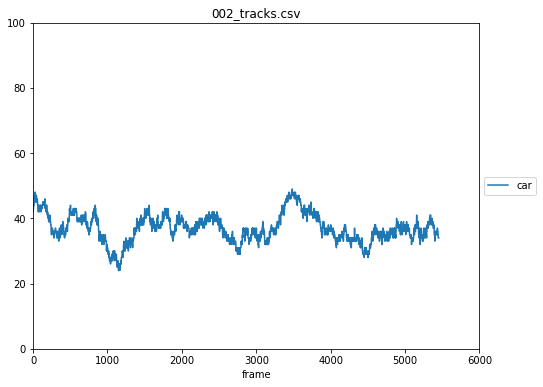

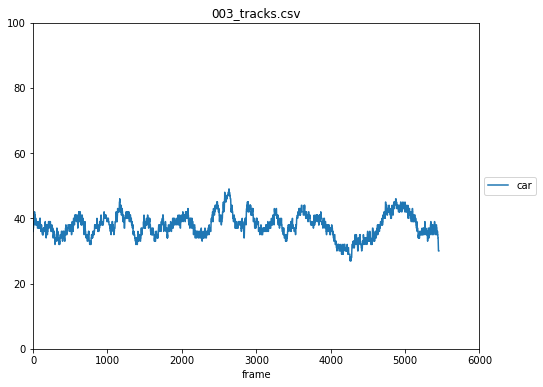

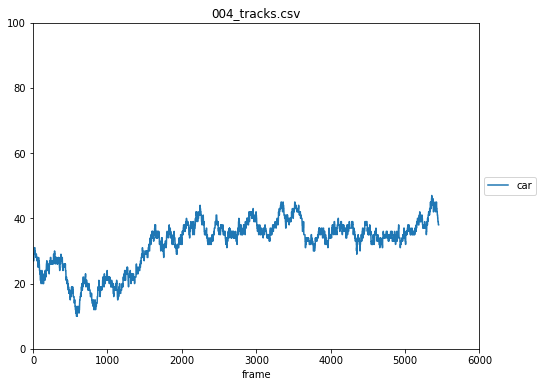

...

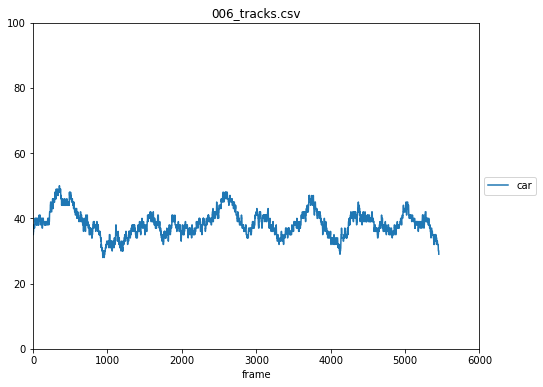

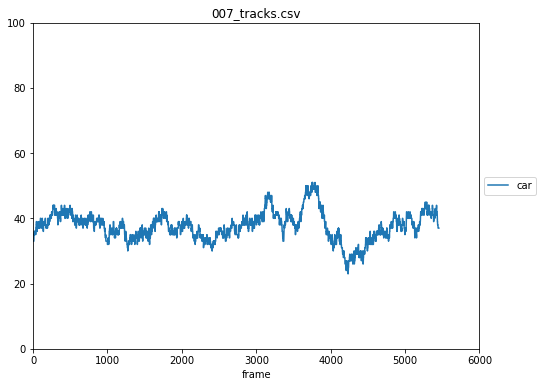

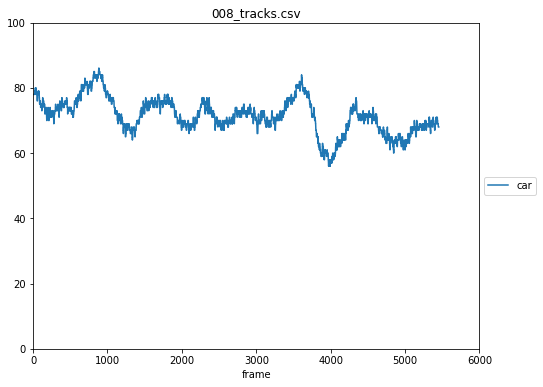

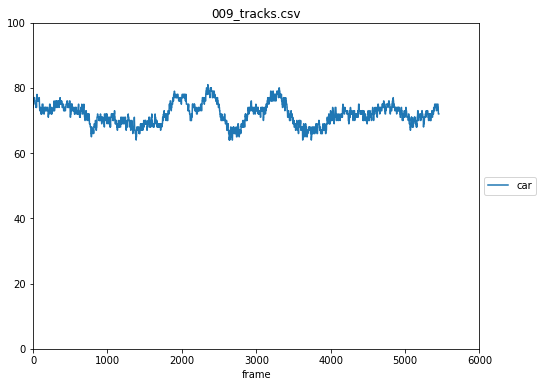

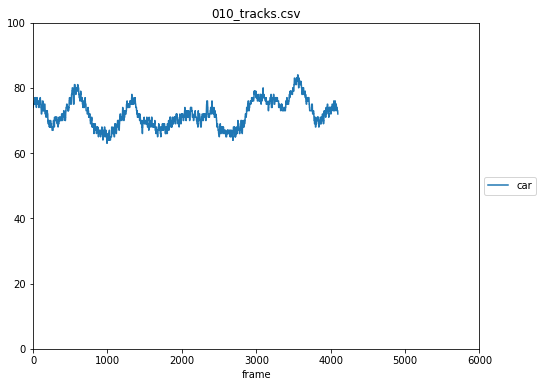

In [ ]:
traffic_density_vis(configs[merging_map_list[1]], x_lim=[0, 6000], y_lim=[0, 100])

## The Roundabout Scenarios

In [ ]:
roundout_map_list = [m for m in map_list if m[0] == "R"]

In [ ]:
duration(configs[roundout_map_list[0]])

Map: R_INTERACTION_0_DEU
Track file                Duration  
000_tracks.csv       3271      
001_tracks.csv       3272      
002_tracks.csv       3272      
003_tracks.csv       3271      
004_tracks.csv       2023      
005_tracks.csv       3272      
006_tracks.csv       3272      
007_tracks.csv       1493      
008_tracks.csv       3262      
009_tracks.csv       2025      
010_tracks.csv       2234      
011_tracks.csv       2250      


In [ ]:
duration(configs[roundout_map_list[1]])

Map: R_INTERACTION_0_CHN
Track file                Duration  
000_tracks.csv       2909      
001_tracks.csv       2908      
002_tracks.csv       2908      
003_tracks.csv       2909      
004_tracks.csv       2906      


In [ ]:
duration(configs[roundout_map_list[2]])

Map: R_INTERACTION_0_USA
Track file                Duration  
000_tracks.csv       1399      
001_tracks.csv       3007      
002_tracks.csv       3007      
003_tracks.csv       3007      
004_tracks.csv       3007      
005_tracks.csv       3007      
006_tracks.csv       3007      
007_tracks.csv       2933      


In [ ]:
duration(configs[roundout_map_list[3]])

Map: R_INTERACTION_1_USA
Track file                Duration  
000_tracks.csv       3007      
001_tracks.csv       3007      
002_tracks.csv       3007      
003_tracks.csv       2759      
004_tracks.csv       3007      
005_tracks.csv       3007      
006_tracks.csv       3007      
007_tracks.csv       3008      
008_tracks.csv       3007      
009_tracks.csv       3007      
010_tracks.csv       3007      
011_tracks.csv       3007      
012_tracks.csv       3006      
013_tracks.csv       960       
014_tracks.csv       3007      
015_tracks.csv       3006      
016_tracks.csv       1268      
017_tracks.csv       3007      
018_tracks.csv       3007      
019_tracks.csv       1456      
020_tracks.csv       3007      
021_tracks.csv       1229      
022_tracks.csv       3007      
023_tracks.csv       3007      
024_tracks.csv       2889      
025_tracks.csv       3007      
026_tracks.csv       3007      
027_tracks.csv       3007      
028_tracks.csv       809       
029_tracks

In [ ]:
duration(configs[roundout_map_list[4]])

Map: R_INTERACTION_2_USA
Track file                Duration  
000_tracks.csv       3007      
001_tracks.csv       2584      
002_tracks.csv       3007      
003_tracks.csv       2730      
004_tracks.csv       344       
005_tracks.csv       3007      
006_tracks.csv       3007      
007_tracks.csv       3007      
008_tracks.csv       3007      
009_tracks.csv       832       


### Proportion of different agent type

There are in total 107 agents in file 000
There are in total 141 agents in file 001
There are in total 113 agents in file 002
There are in total 124 agents in file 003
There are in total 84 agents in file 004
There are in total 99 agents in file 005
There are in total 120 agents in file 006
There are in total 41 agents in file 007
There are in total 82 agents in file 008
There are in total 89 agents in file 009
There are in total 100 agents in file 010
There are in total 65 agents in file 011


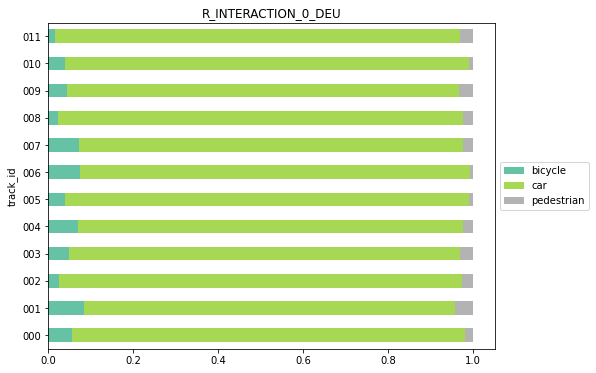

In [ ]:
type_vis(configs[roundout_map_list[0]])

There are in total 36 agents in file 000
There are in total 50 agents in file 001
There are in total 42 agents in file 002
There are in total 59 agents in file 003
There are in total 36 agents in file 004


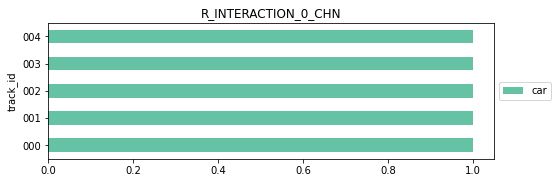

In [ ]:
type_vis(configs[roundout_map_list[1]])

There are in total 78 agents in file 000
There are in total 138 agents in file 001
There are in total 130 agents in file 002
There are in total 117 agents in file 003
There are in total 123 agents in file 004
There are in total 136 agents in file 005
There are in total 141 agents in file 006
There are in total 147 agents in file 007


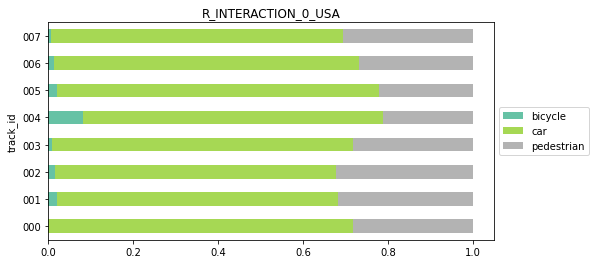

In [ ]:
type_vis(configs[roundout_map_list[2]])

There are in total 163 agents in file 000
There are in total 150 agents in file 001
There are in total 173 agents in file 002
There are in total 145 agents in file 003
There are in total 178 agents in file 004
There are in total 183 agents in file 005
There are in total 197 agents in file 006
There are in total 185 agents in file 007
There are in total 204 agents in file 008
There are in total 201 agents in file 009
There are in total 201 agents in file 010
There are in total 176 agents in file 011
There are in total 188 agents in file 012
There are in total 68 agents in file 013
There are in total 200 agents in file 014
There are in total 204 agents in file 015
There are in total 99 agents in file 016
There are in total 214 agents in file 017
There are in total 211 agents in file 018
There are in total 108 agents in file 019
There are in total 186 agents in file 020
There are in total 75 agents in file 021
There are in total 178 agents in file 022
There are in total 203 agents in file

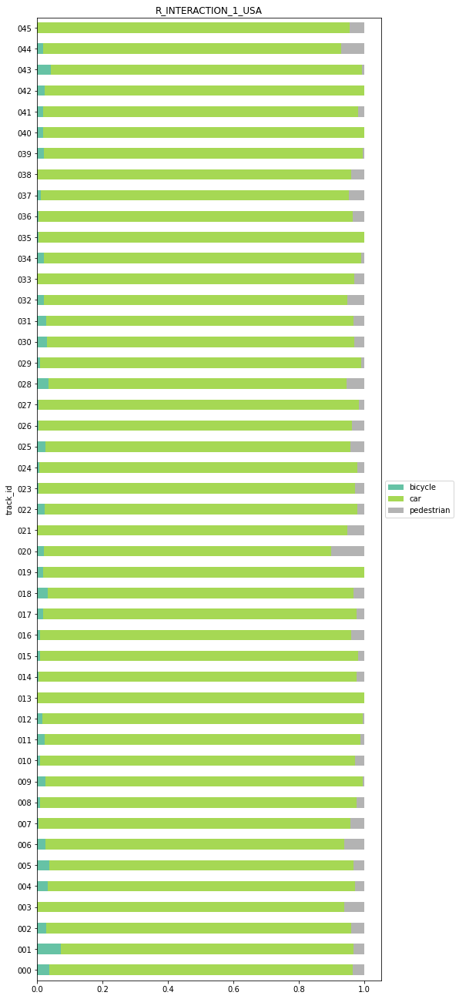

In [ ]:
type_vis(configs[roundout_map_list[3]])

There are in total 169 agents in file 000
There are in total 162 agents in file 001
There are in total 195 agents in file 002
There are in total 191 agents in file 003
There are in total 36 agents in file 004
There are in total 153 agents in file 005
There are in total 158 agents in file 006
There are in total 141 agents in file 007
There are in total 143 agents in file 008
There are in total 43 agents in file 009


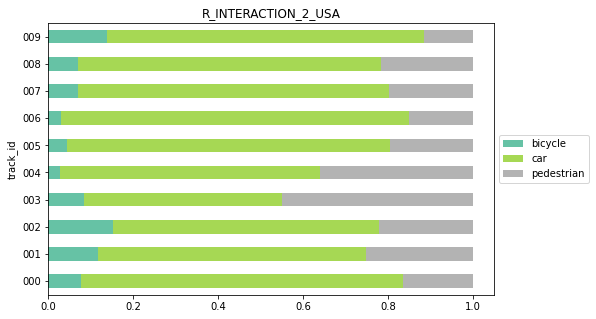

In [ ]:
type_vis(configs[roundout_map_list[4]])

### Speed Distribution

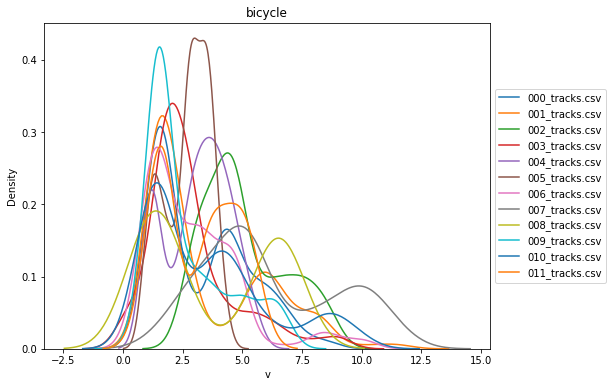

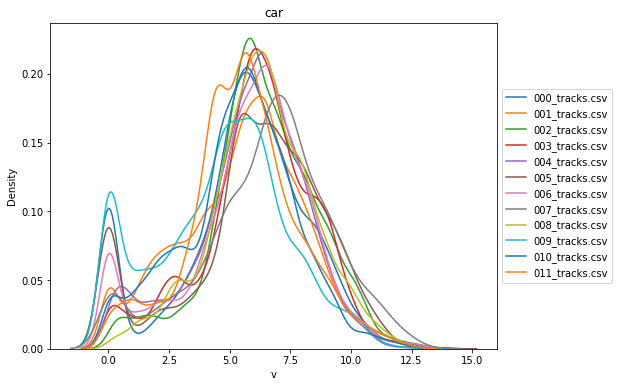

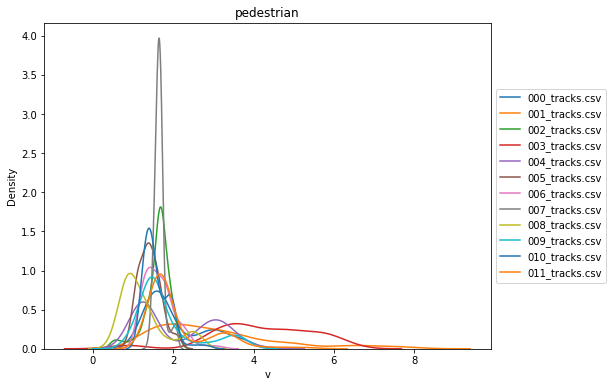

In [ ]:
speed_dist_vis(configs[roundout_map_list[0]], ["bicycle", "car", "pedestrian"])

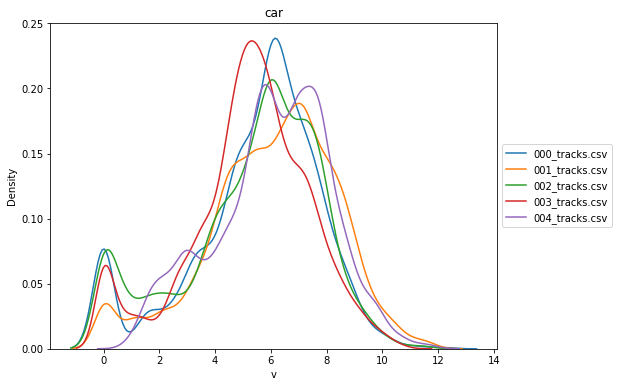

In [ ]:
speed_dist_vis(configs[roundout_map_list[1]], ["car"])

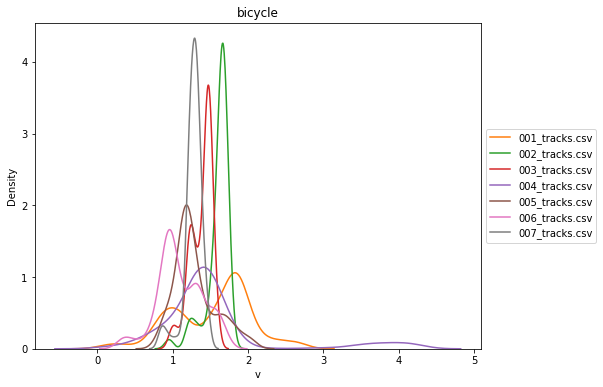

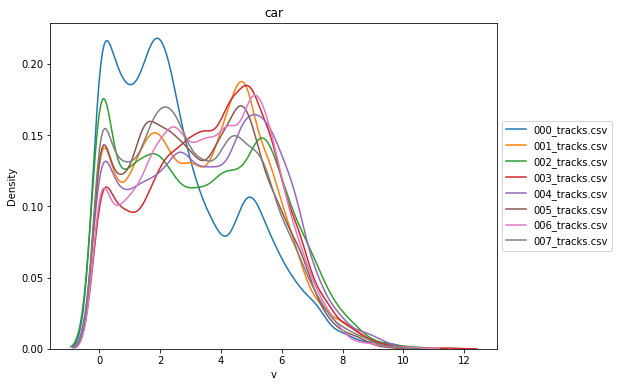

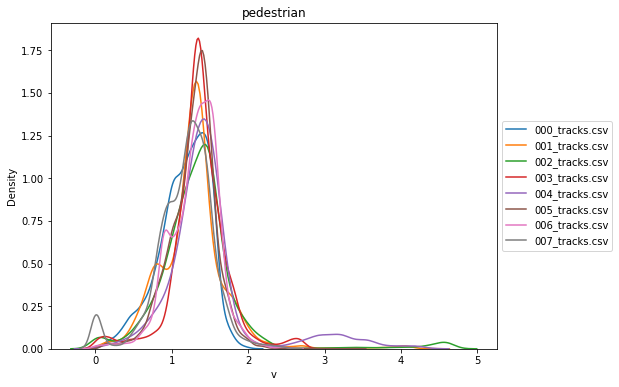

In [ ]:
speed_dist_vis(configs[roundout_map_list[2]], ["bicycle", "car", "pedestrian"])

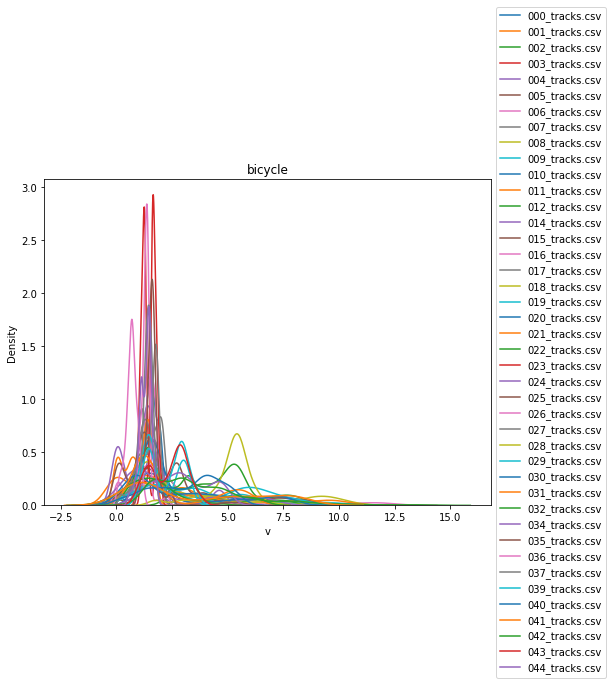

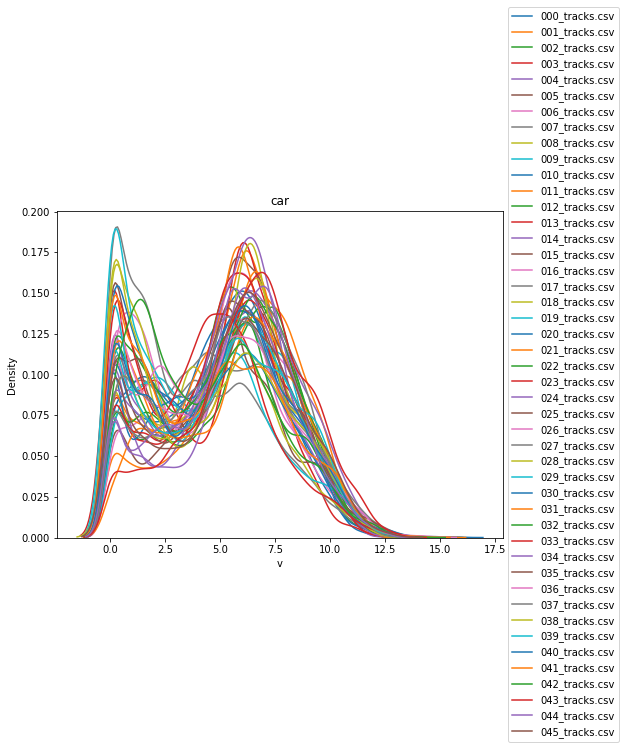

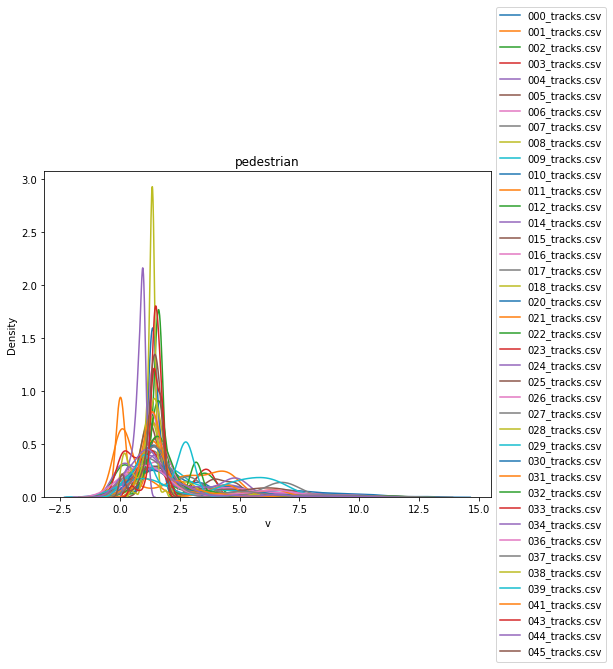

In [ ]:
speed_dist_vis(configs[roundout_map_list[3]], ["bicycle", "car", "pedestrian"])

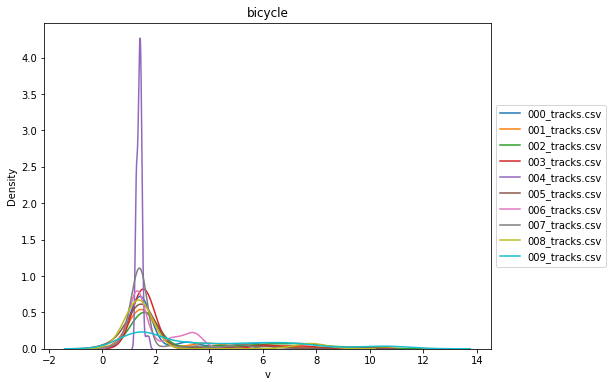

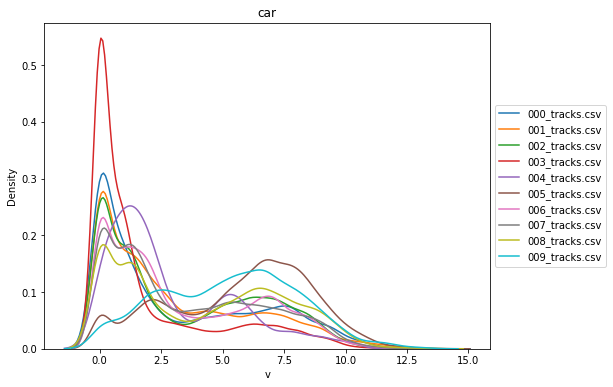

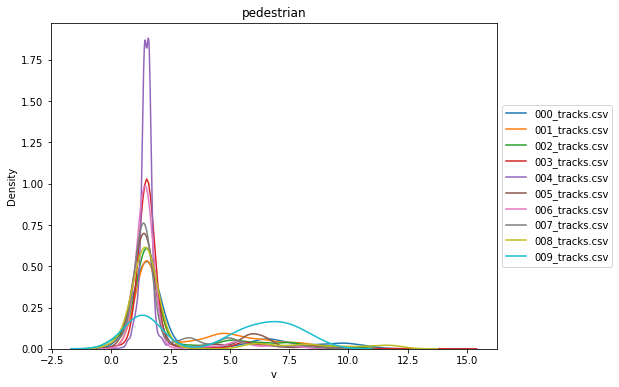

In [ ]:
speed_dist_vis(configs[roundout_map_list[4]], ["bicycle", "car", "pedestrian"])

### Angle Distribution

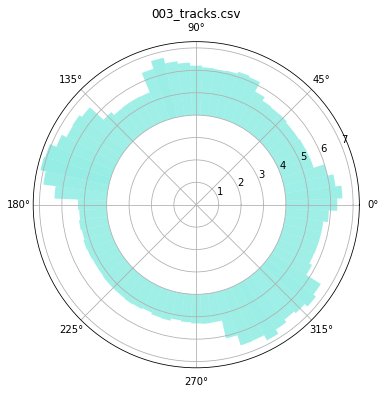

In [ ]:
angle_dist_vis(configs[roundout_map_list[0]], "car")

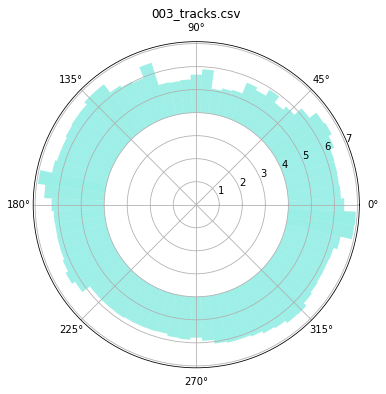

In [ ]:
angle_dist_vis(configs[roundout_map_list[1]], "car")

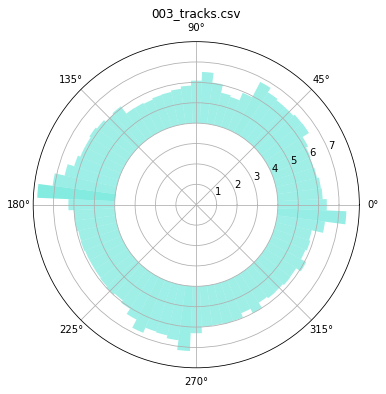

In [ ]:
angle_dist_vis(configs[roundout_map_list[2]], "car")

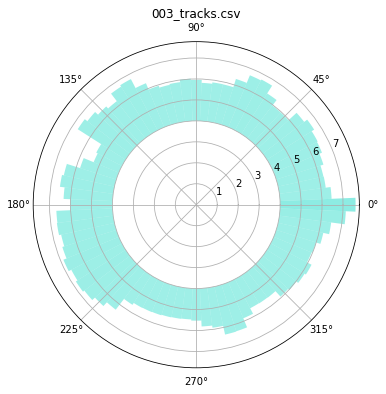

In [ ]:
angle_dist_vis(configs[roundout_map_list[3]], "car")

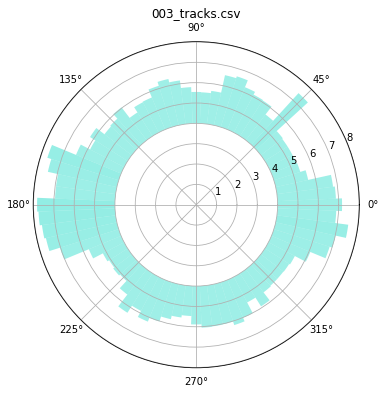

In [ ]:
angle_dist_vis(configs[roundout_map_list[4]], "car")

### Traffic Density

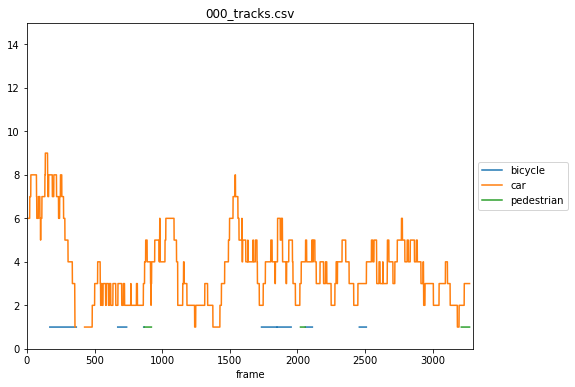

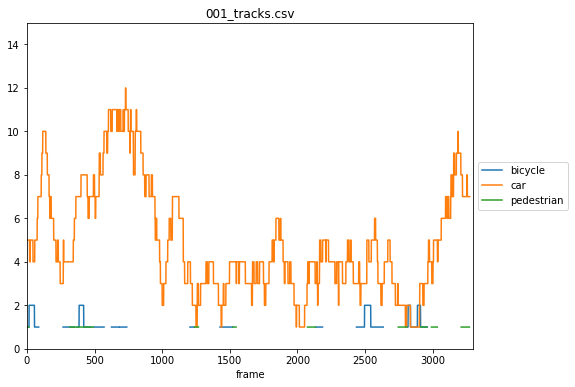

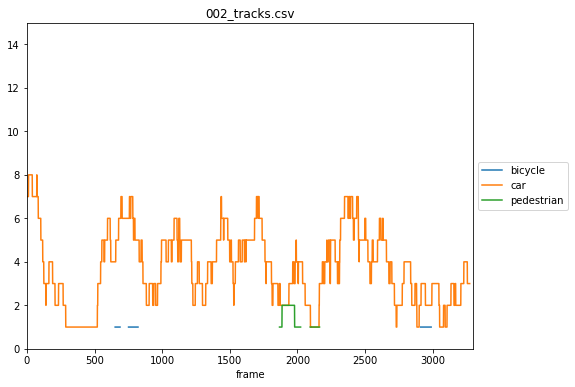

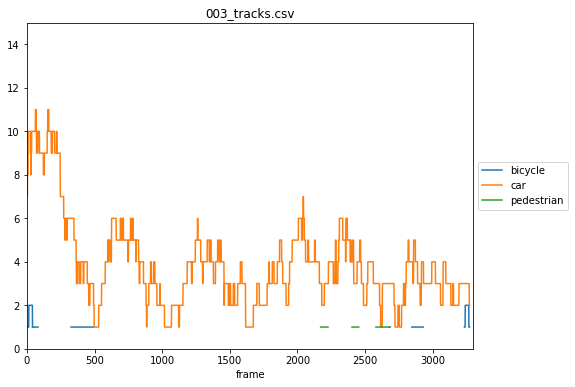

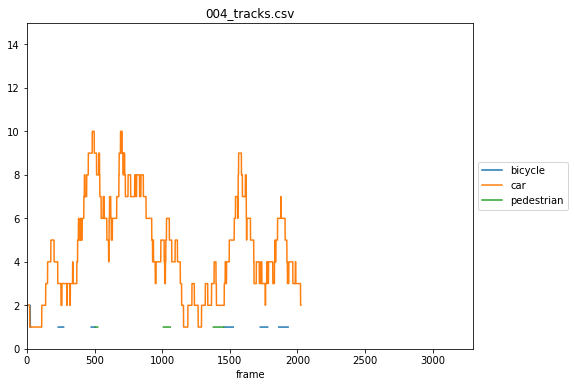

...

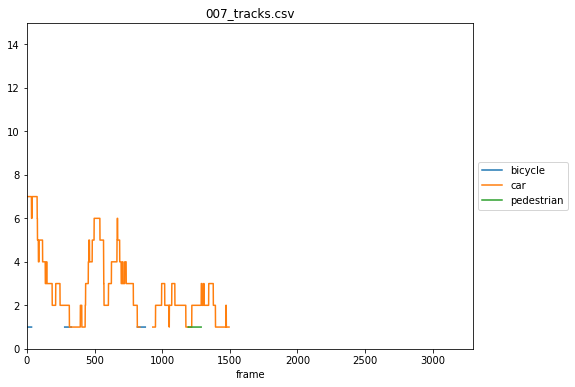

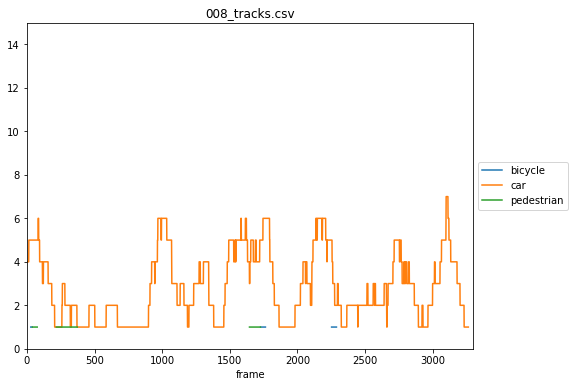

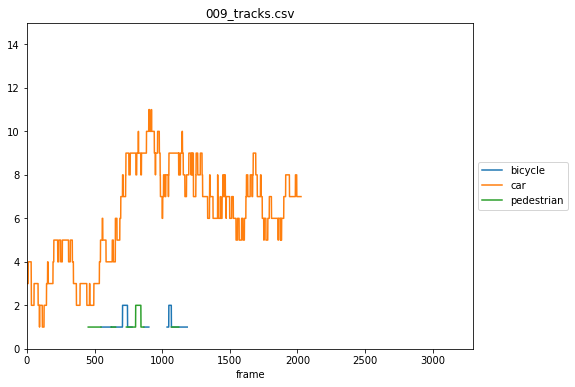

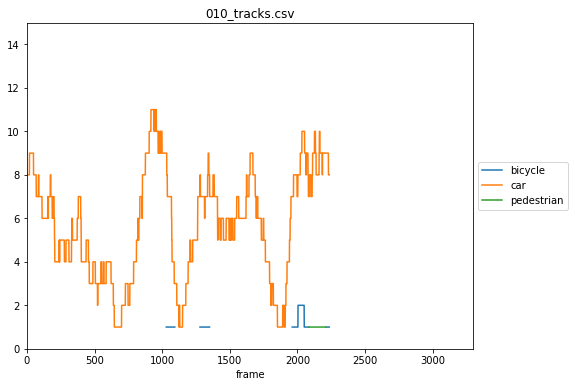

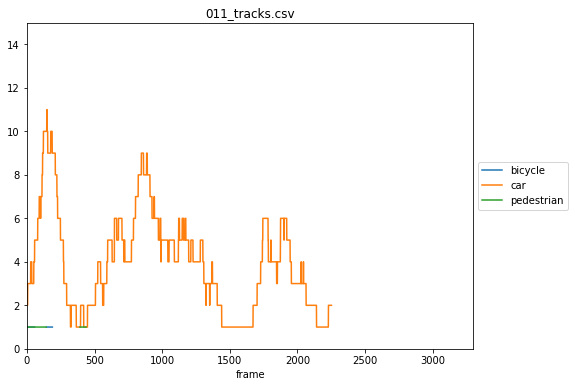

In [ ]:
traffic_density_vis(configs[roundout_map_list[0]], x_lim=[0, 3300], y_lim=[0, 15])

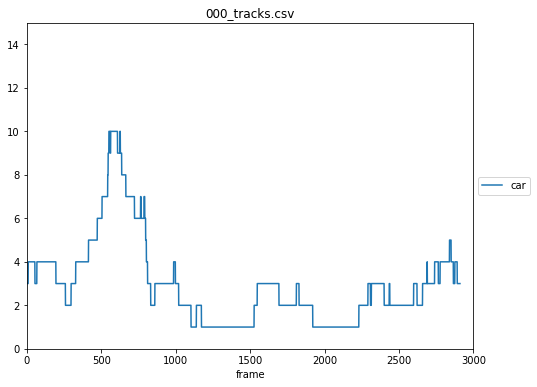

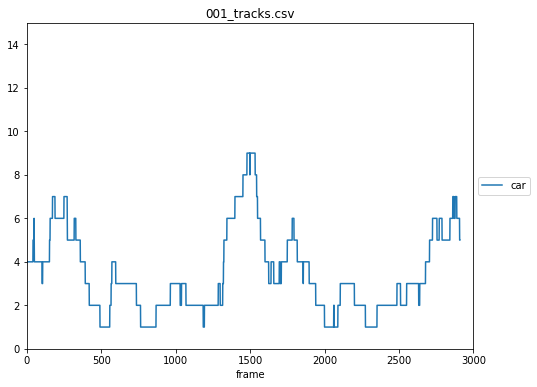

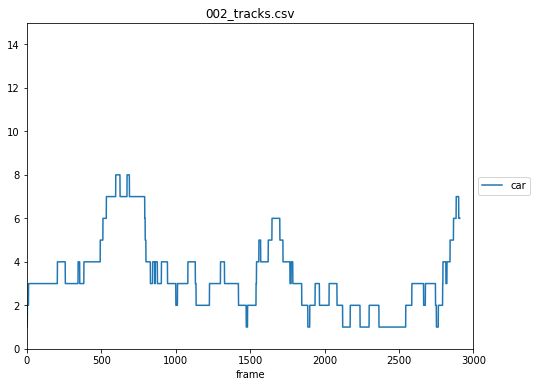

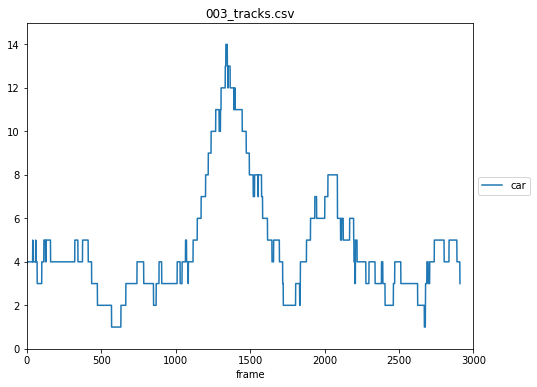

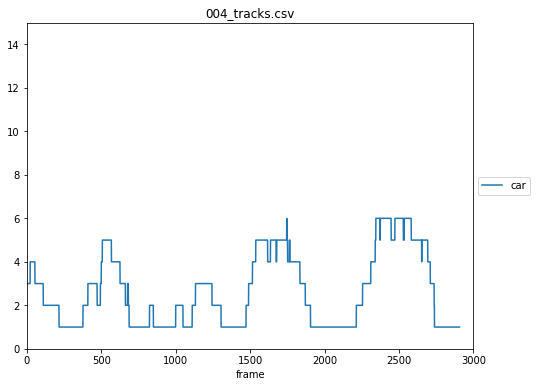

In [ ]:
traffic_density_vis(configs[roundout_map_list[1]], x_lim=[0, 3000], y_lim=[0, 15])

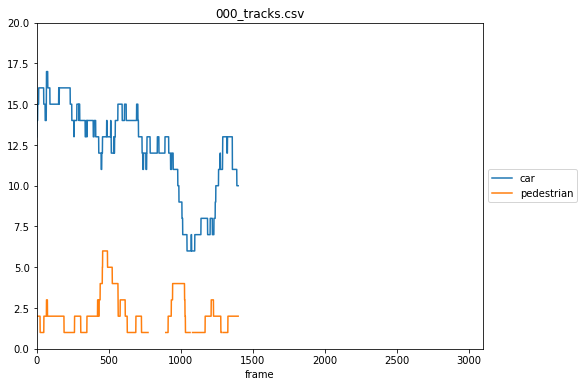

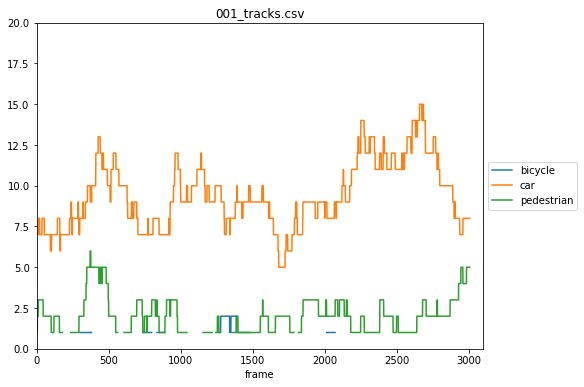

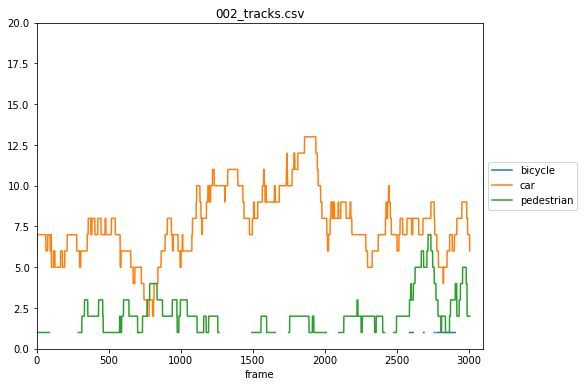

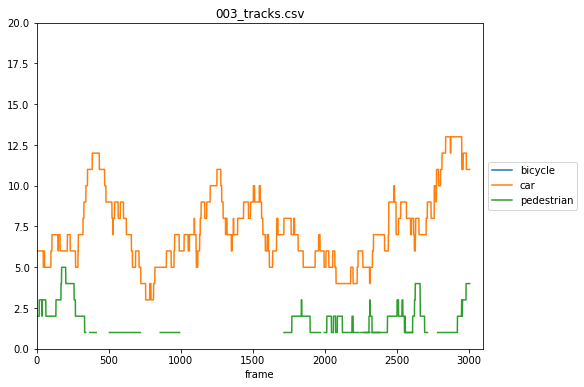

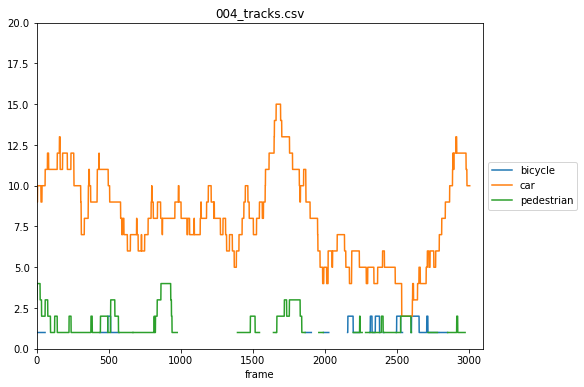

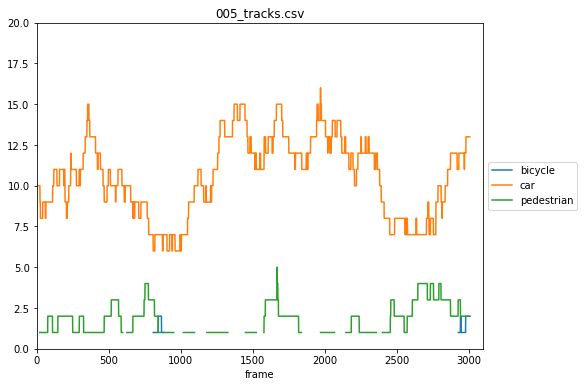

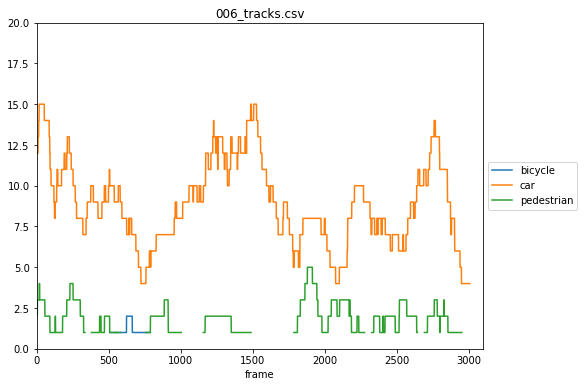

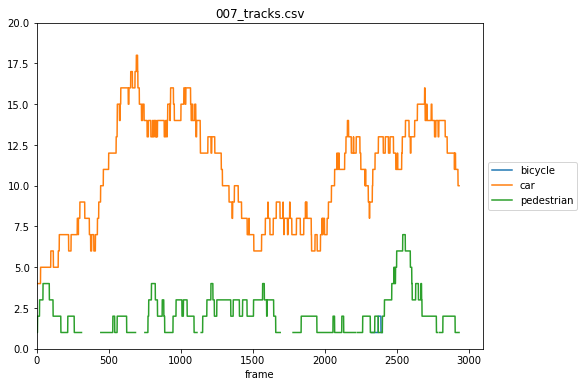

In [ ]:
traffic_density_vis(configs[roundout_map_list[2]], x_lim=[0, 3100], y_lim=[0, 20])

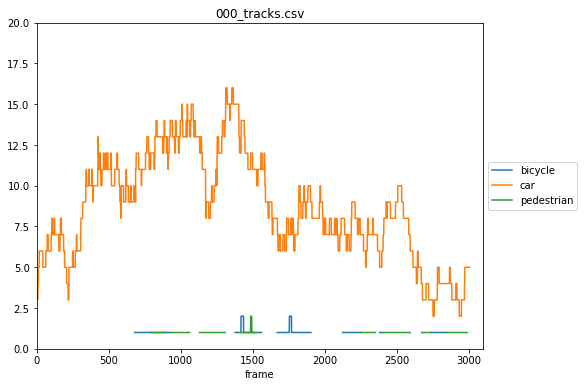

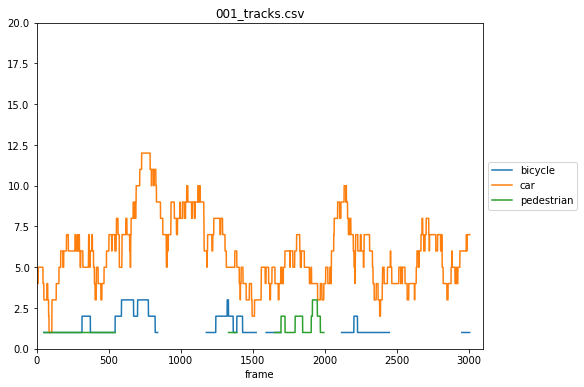

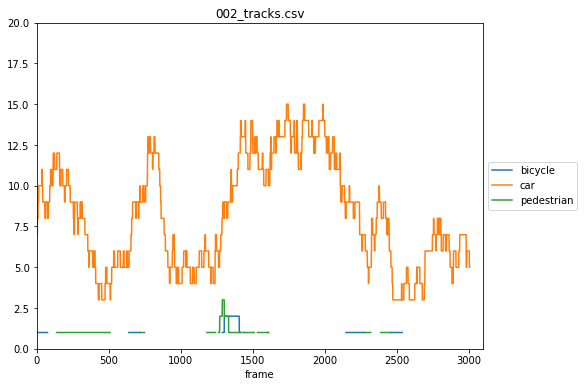

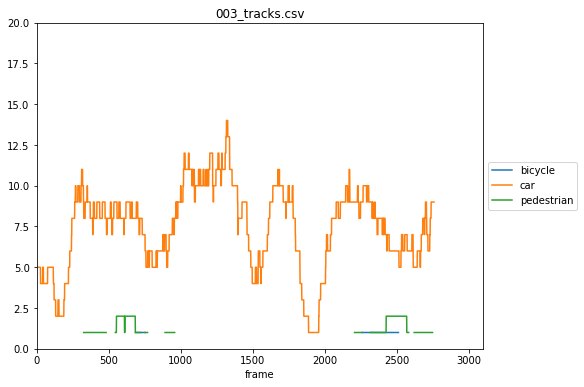

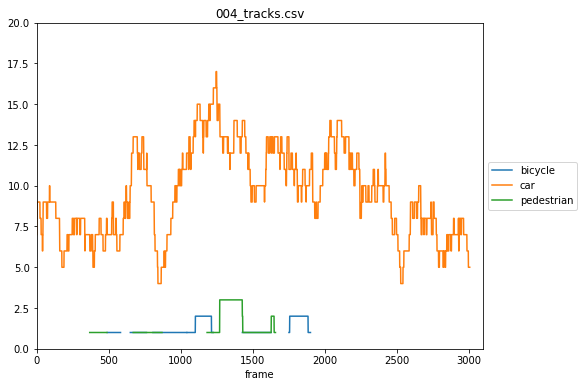

...

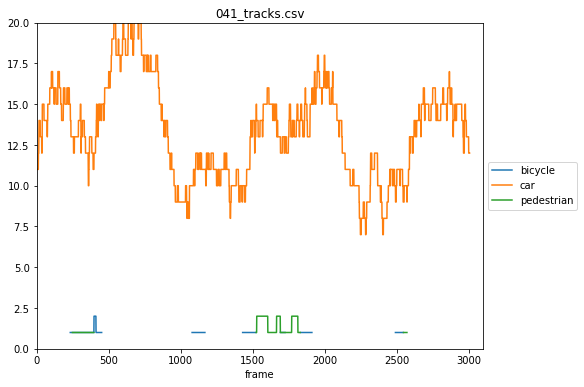

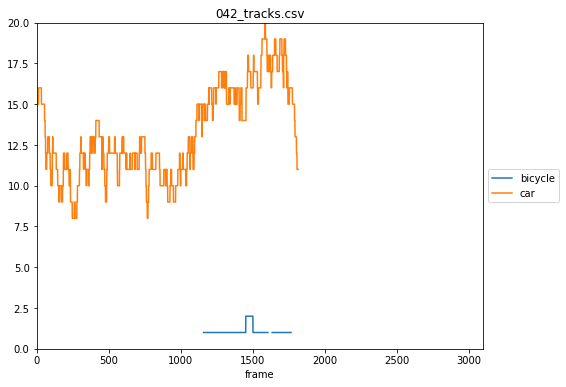

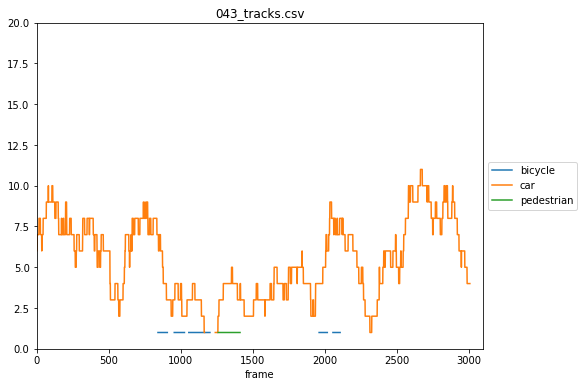

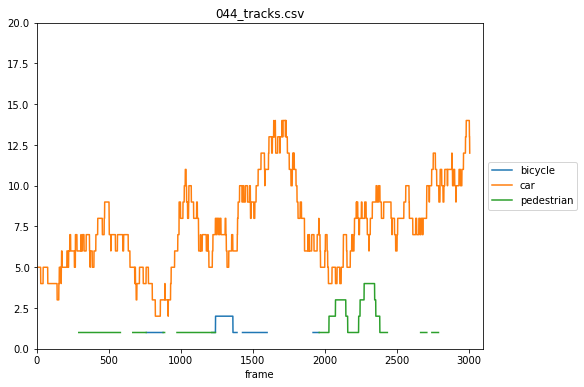

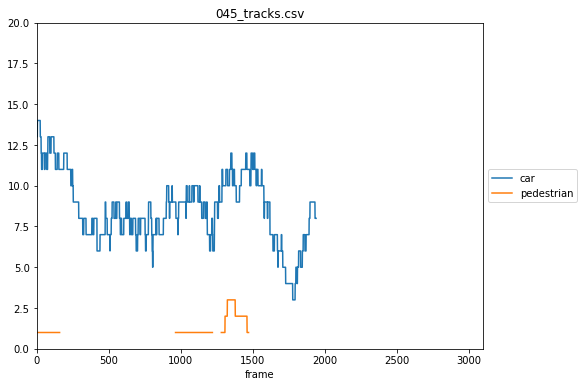

In [ ]:
traffic_density_vis(configs[roundout_map_list[3]], x_lim=[0, 3100], y_lim=[0, 20])

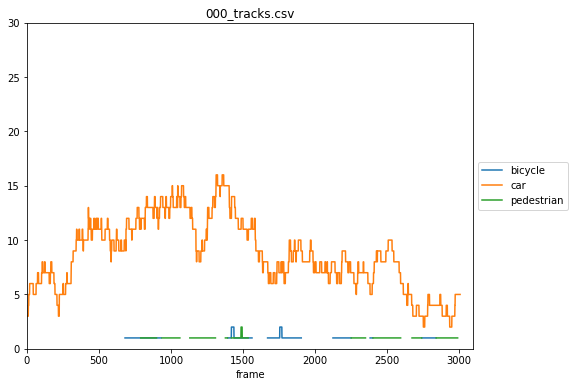

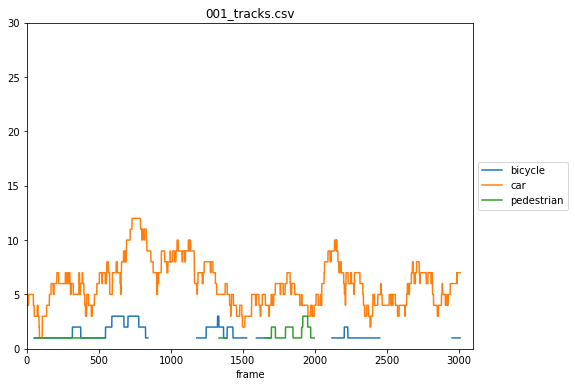

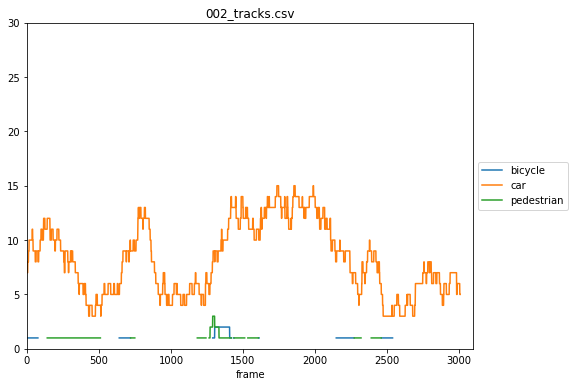

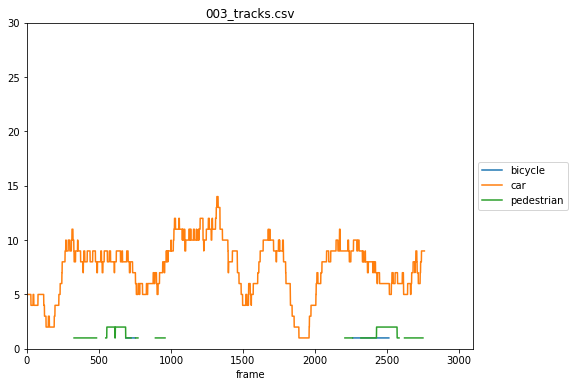

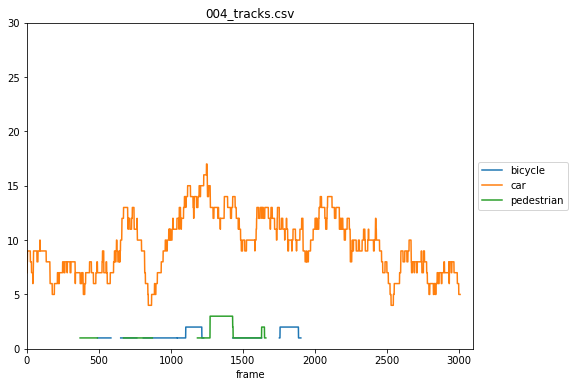

...

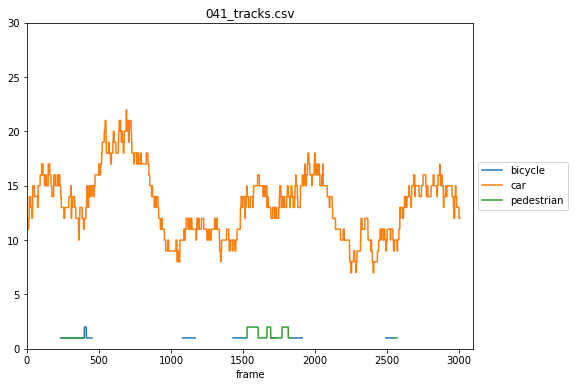

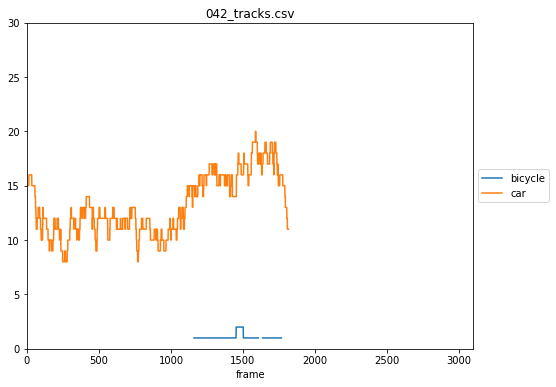

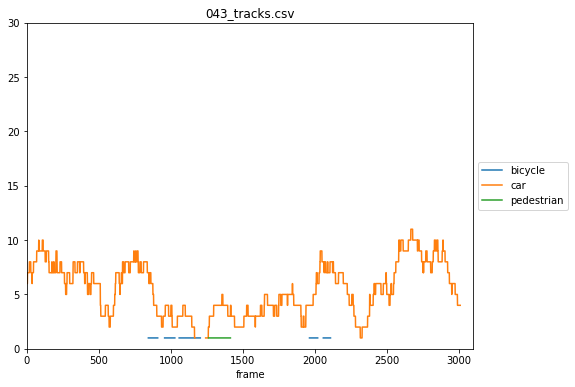

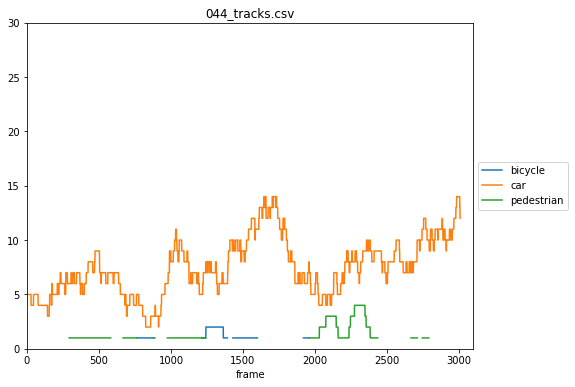

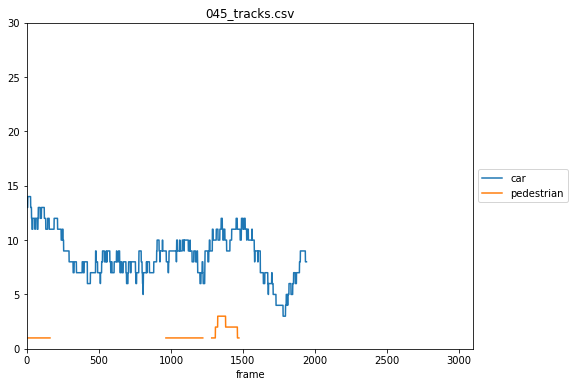

In [ ]:
traffic_density_vis(configs[roundout_map_list[3]], x_lim=[0, 3100], y_lim=[0, 30])

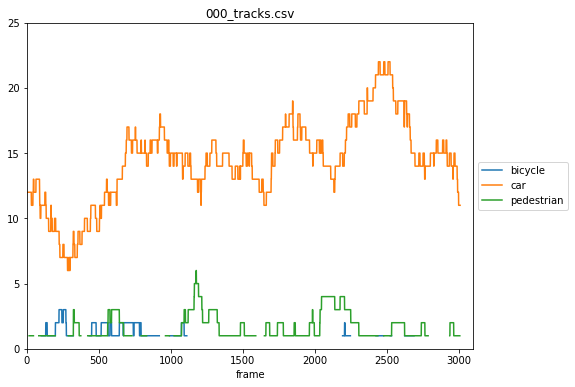

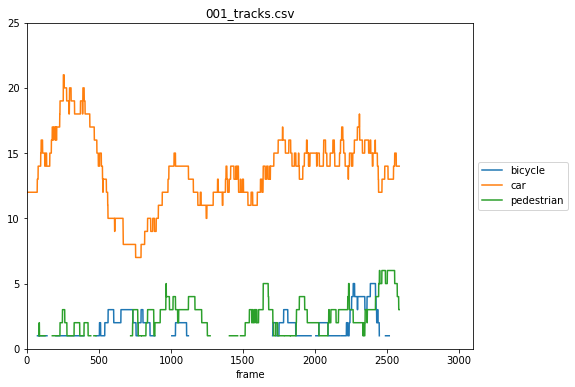

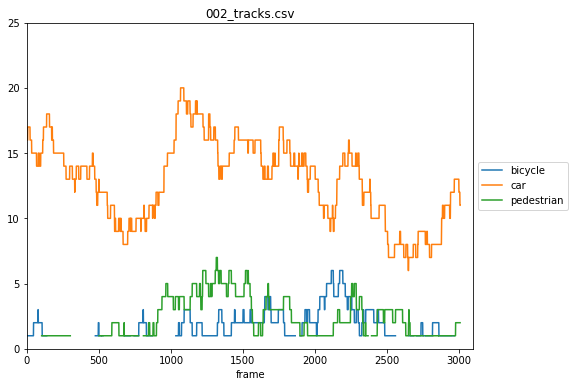

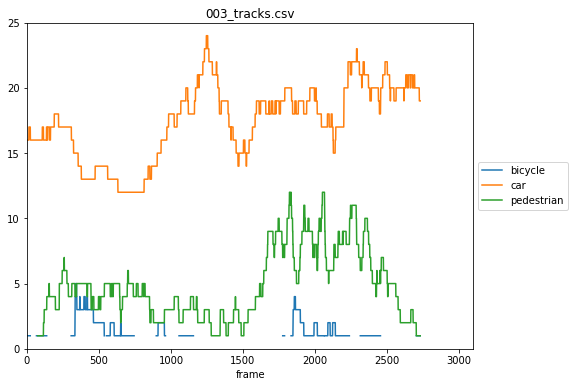

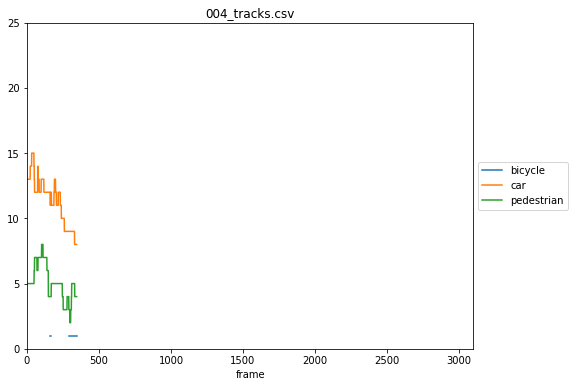

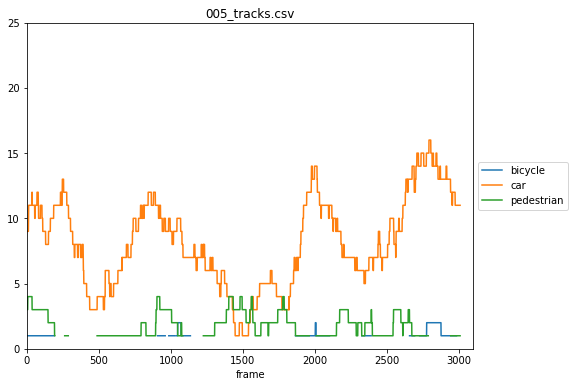

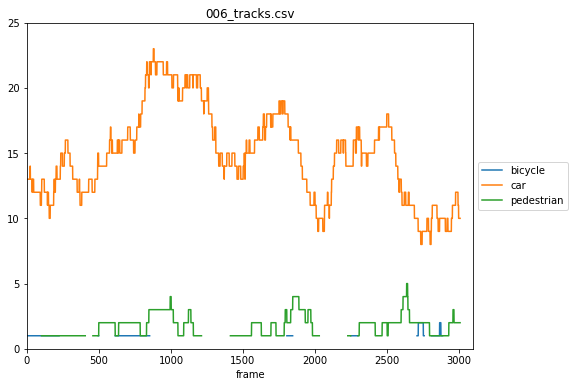

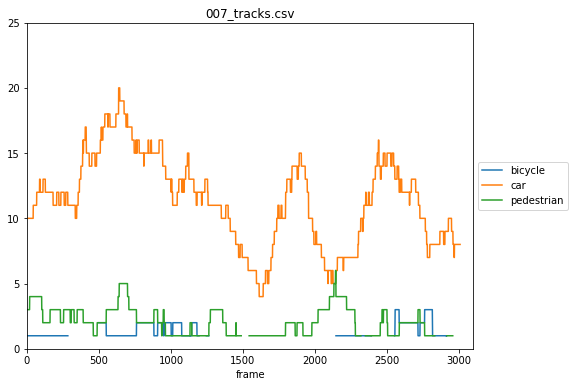

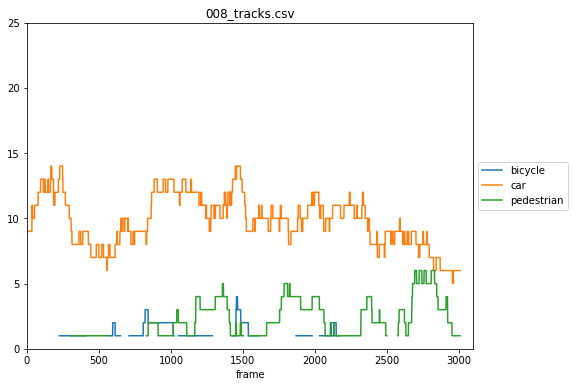

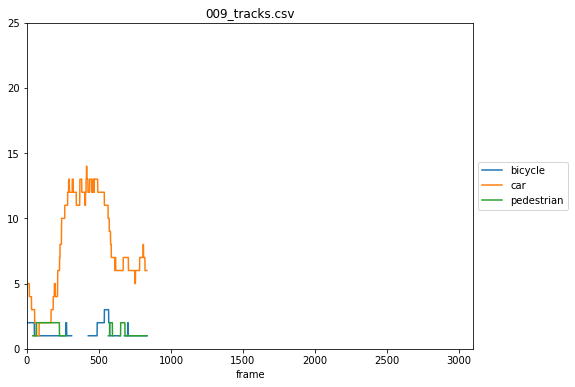

In [ ]:
traffic_density_vis(configs[roundout_map_list[4]], x_lim=[0, 3100], y_lim=[0, 25])